# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [4]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [5]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [6]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:04, 42.9MB/s]                            
SVHN Testing Set: 64.3MB [00:01, 35.3MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [7]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

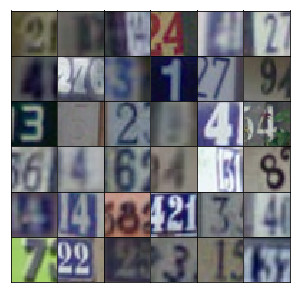

In [8]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [9]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [10]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [11]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None,) + tuple(real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [12]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape
        x1 = tf.reshape(x1, [-1, 4, 4, 512])
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [13]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 128, 5, strides=2, padding='same')
        #x1 = tf.layers.batch_normalization(x1, training=True)
        x1 = tf.maximum(alpha * x1, x1)
        #16x16x128
        
        x2 = tf.layers.conv2d(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256
        
        x3 = tf.layers.conv2d(x2, 512, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        # 4x4x512
        
        flat = tf.reshape(x3, (-1, 4*4*512))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [14]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [15]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [16]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [17]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [18]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [19]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 4.7121... Generator Loss: 0.0127
Epoch 1/25... Discriminator Loss: 0.2397... Generator Loss: 22.9694
Epoch 1/25... Discriminator Loss: 0.0191... Generator Loss: 13.3785
Epoch 1/25... Discriminator Loss: 0.0873... Generator Loss: 5.2516
Epoch 1/25... Discriminator Loss: 0.0761... Generator Loss: 13.1815
Epoch 1/25... Discriminator Loss: 0.1990... Generator Loss: 3.7486
Epoch 1/25... Discriminator Loss: 0.9520... Generator Loss: 3.9116
Epoch 1/25... Discriminator Loss: 0.8973... Generator Loss: 0.9106
Epoch 1/25... Discriminator Loss: 0.6064... Generator Loss: 2.6517
Epoch 1/25... Discriminator Loss: 0.4039... Generator Loss: 1.5657


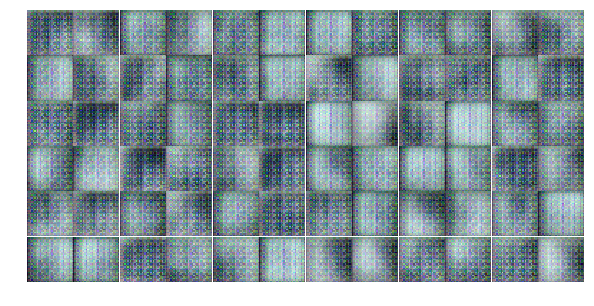

Epoch 1/25... Discriminator Loss: 0.2274... Generator Loss: 3.0556
Epoch 1/25... Discriminator Loss: 0.9913... Generator Loss: 1.0636
Epoch 1/25... Discriminator Loss: 0.4746... Generator Loss: 1.4215
Epoch 1/25... Discriminator Loss: 0.4418... Generator Loss: 4.3562
Epoch 1/25... Discriminator Loss: 0.3747... Generator Loss: 1.6523
Epoch 1/25... Discriminator Loss: 0.4536... Generator Loss: 2.6237
Epoch 1/25... Discriminator Loss: 0.9980... Generator Loss: 2.8673
Epoch 1/25... Discriminator Loss: 0.9458... Generator Loss: 0.6288
Epoch 1/25... Discriminator Loss: 1.0580... Generator Loss: 2.3715
Epoch 1/25... Discriminator Loss: 0.9214... Generator Loss: 0.9727


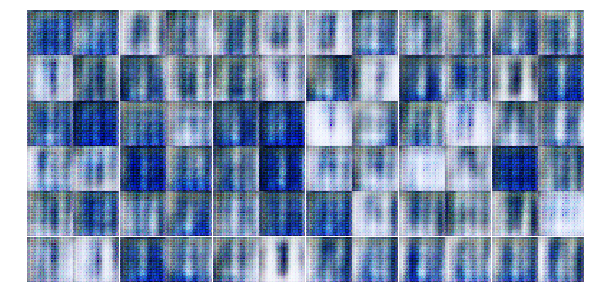

Epoch 1/25... Discriminator Loss: 0.9666... Generator Loss: 0.8995
Epoch 1/25... Discriminator Loss: 0.2782... Generator Loss: 2.8575
Epoch 1/25... Discriminator Loss: 0.2702... Generator Loss: 1.9390
Epoch 1/25... Discriminator Loss: 0.7508... Generator Loss: 0.9817
Epoch 1/25... Discriminator Loss: 1.0887... Generator Loss: 1.6581
Epoch 1/25... Discriminator Loss: 1.3088... Generator Loss: 1.0292
Epoch 1/25... Discriminator Loss: 0.6615... Generator Loss: 2.4248
Epoch 1/25... Discriminator Loss: 0.2810... Generator Loss: 2.8312
Epoch 1/25... Discriminator Loss: 0.5615... Generator Loss: 1.5853
Epoch 1/25... Discriminator Loss: 0.6511... Generator Loss: 2.5412


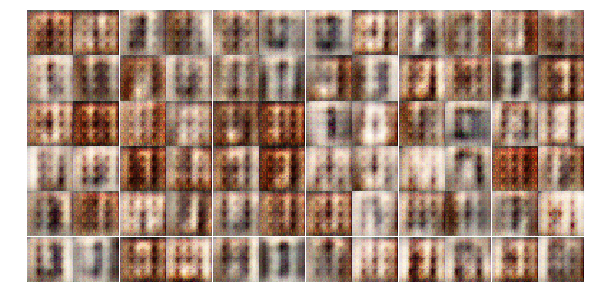

Epoch 1/25... Discriminator Loss: 0.4999... Generator Loss: 1.4089
Epoch 1/25... Discriminator Loss: 0.5123... Generator Loss: 1.5517
Epoch 1/25... Discriminator Loss: 0.4864... Generator Loss: 1.8301
Epoch 1/25... Discriminator Loss: 0.5556... Generator Loss: 1.4175
Epoch 1/25... Discriminator Loss: 0.4259... Generator Loss: 1.7927
Epoch 1/25... Discriminator Loss: 0.9194... Generator Loss: 1.3999
Epoch 1/25... Discriminator Loss: 0.5699... Generator Loss: 1.3549
Epoch 1/25... Discriminator Loss: 0.7332... Generator Loss: 1.3884
Epoch 1/25... Discriminator Loss: 0.5630... Generator Loss: 1.8146
Epoch 1/25... Discriminator Loss: 1.1022... Generator Loss: 2.9033


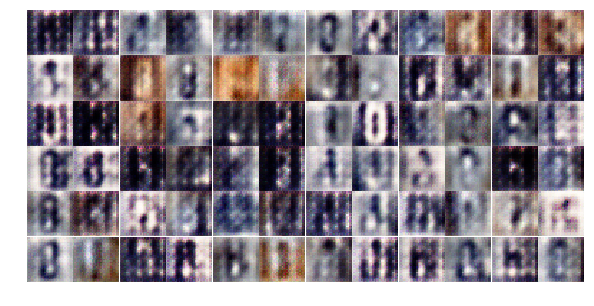

Epoch 1/25... Discriminator Loss: 1.1832... Generator Loss: 0.8272
Epoch 1/25... Discriminator Loss: 0.4189... Generator Loss: 2.4081
Epoch 1/25... Discriminator Loss: 0.5615... Generator Loss: 1.9270
Epoch 1/25... Discriminator Loss: 0.9406... Generator Loss: 0.8153
Epoch 1/25... Discriminator Loss: 0.5997... Generator Loss: 2.2327
Epoch 1/25... Discriminator Loss: 1.0342... Generator Loss: 0.9418
Epoch 1/25... Discriminator Loss: 0.4948... Generator Loss: 1.7708
Epoch 1/25... Discriminator Loss: 0.6267... Generator Loss: 2.0046
Epoch 1/25... Discriminator Loss: 0.4840... Generator Loss: 1.6751
Epoch 1/25... Discriminator Loss: 2.0207... Generator Loss: 0.2662


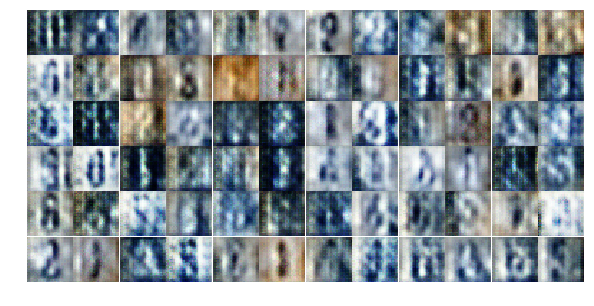

Epoch 1/25... Discriminator Loss: 1.0601... Generator Loss: 0.6726
Epoch 1/25... Discriminator Loss: 0.8702... Generator Loss: 0.9255
Epoch 1/25... Discriminator Loss: 1.3008... Generator Loss: 0.5712
Epoch 1/25... Discriminator Loss: 0.8386... Generator Loss: 1.0173
Epoch 1/25... Discriminator Loss: 0.5521... Generator Loss: 1.7901
Epoch 1/25... Discriminator Loss: 0.9474... Generator Loss: 0.7673
Epoch 1/25... Discriminator Loss: 0.4876... Generator Loss: 1.9596
Epoch 2/25... Discriminator Loss: 0.7345... Generator Loss: 1.7877
Epoch 2/25... Discriminator Loss: 0.7817... Generator Loss: 1.9654
Epoch 2/25... Discriminator Loss: 1.0085... Generator Loss: 0.9174


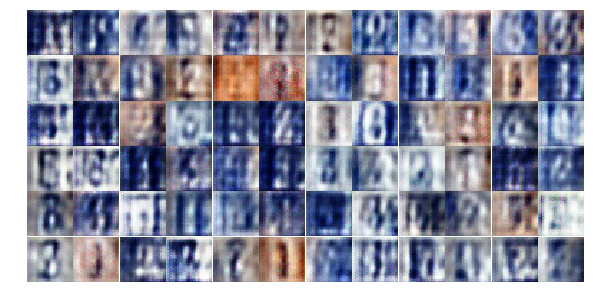

Epoch 2/25... Discriminator Loss: 0.9651... Generator Loss: 1.0015
Epoch 2/25... Discriminator Loss: 1.0235... Generator Loss: 0.7538
Epoch 2/25... Discriminator Loss: 1.0214... Generator Loss: 0.9908
Epoch 2/25... Discriminator Loss: 1.3093... Generator Loss: 1.5564
Epoch 2/25... Discriminator Loss: 0.9947... Generator Loss: 0.8183
Epoch 2/25... Discriminator Loss: 1.0392... Generator Loss: 1.1234
Epoch 2/25... Discriminator Loss: 1.0255... Generator Loss: 1.2160
Epoch 2/25... Discriminator Loss: 0.5821... Generator Loss: 1.5314
Epoch 2/25... Discriminator Loss: 0.9780... Generator Loss: 1.2026
Epoch 2/25... Discriminator Loss: 1.3714... Generator Loss: 0.5506


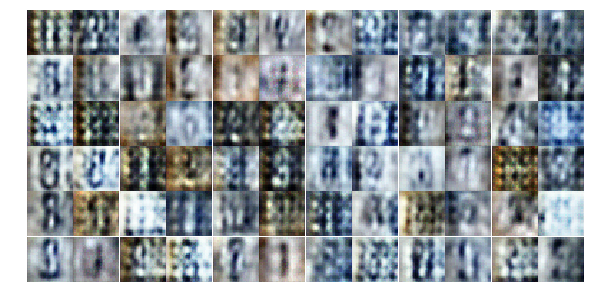

Epoch 2/25... Discriminator Loss: 1.1583... Generator Loss: 0.7742
Epoch 2/25... Discriminator Loss: 0.8937... Generator Loss: 1.5819
Epoch 2/25... Discriminator Loss: 0.8992... Generator Loss: 0.8794
Epoch 2/25... Discriminator Loss: 0.7262... Generator Loss: 1.6814
Epoch 2/25... Discriminator Loss: 1.5346... Generator Loss: 0.6495
Epoch 2/25... Discriminator Loss: 1.0298... Generator Loss: 0.9457
Epoch 2/25... Discriminator Loss: 1.2992... Generator Loss: 0.6246
Epoch 2/25... Discriminator Loss: 0.9063... Generator Loss: 0.9881
Epoch 2/25... Discriminator Loss: 0.8544... Generator Loss: 1.3096
Epoch 2/25... Discriminator Loss: 0.7957... Generator Loss: 1.1538


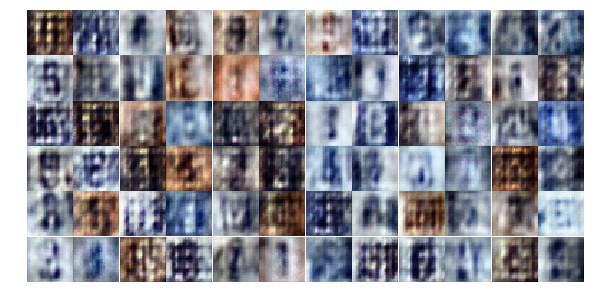

Epoch 2/25... Discriminator Loss: 1.0492... Generator Loss: 0.7731
Epoch 2/25... Discriminator Loss: 0.8608... Generator Loss: 1.7892
Epoch 2/25... Discriminator Loss: 0.8437... Generator Loss: 1.2656
Epoch 2/25... Discriminator Loss: 0.7034... Generator Loss: 1.6890
Epoch 2/25... Discriminator Loss: 0.6890... Generator Loss: 1.3192
Epoch 2/25... Discriminator Loss: 0.7056... Generator Loss: 1.4832
Epoch 2/25... Discriminator Loss: 0.5923... Generator Loss: 2.3593
Epoch 2/25... Discriminator Loss: 0.8366... Generator Loss: 1.2819
Epoch 2/25... Discriminator Loss: 0.9951... Generator Loss: 0.8931
Epoch 2/25... Discriminator Loss: 0.7574... Generator Loss: 1.1836


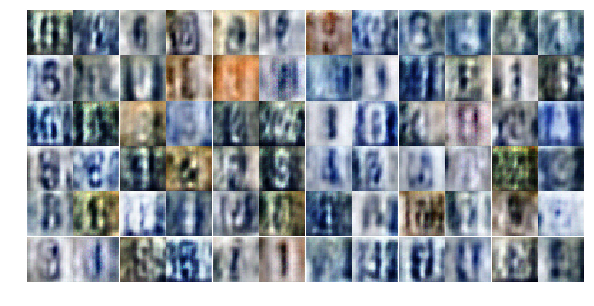

Epoch 2/25... Discriminator Loss: 1.1287... Generator Loss: 0.7606
Epoch 2/25... Discriminator Loss: 1.0571... Generator Loss: 0.6588
Epoch 2/25... Discriminator Loss: 0.8419... Generator Loss: 0.9942
Epoch 2/25... Discriminator Loss: 0.8864... Generator Loss: 0.9747
Epoch 2/25... Discriminator Loss: 0.7875... Generator Loss: 1.8312
Epoch 2/25... Discriminator Loss: 0.7459... Generator Loss: 2.0958
Epoch 2/25... Discriminator Loss: 1.1724... Generator Loss: 1.4584
Epoch 2/25... Discriminator Loss: 1.5913... Generator Loss: 0.4957
Epoch 2/25... Discriminator Loss: 0.8717... Generator Loss: 0.9730
Epoch 2/25... Discriminator Loss: 0.8845... Generator Loss: 2.2189


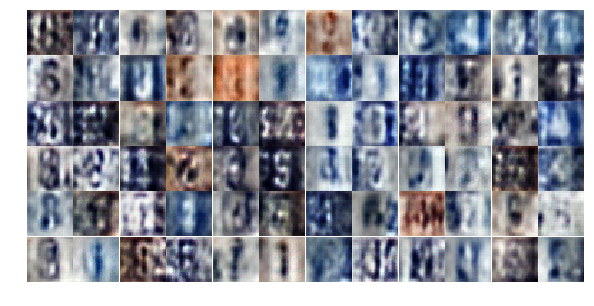

Epoch 2/25... Discriminator Loss: 0.7174... Generator Loss: 1.5383
Epoch 2/25... Discriminator Loss: 0.8038... Generator Loss: 1.2575
Epoch 2/25... Discriminator Loss: 0.6604... Generator Loss: 1.5862
Epoch 2/25... Discriminator Loss: 0.7970... Generator Loss: 1.0484
Epoch 2/25... Discriminator Loss: 0.7926... Generator Loss: 1.1972
Epoch 2/25... Discriminator Loss: 0.8574... Generator Loss: 0.8543
Epoch 2/25... Discriminator Loss: 0.4888... Generator Loss: 1.9785
Epoch 2/25... Discriminator Loss: 0.7968... Generator Loss: 1.7097
Epoch 2/25... Discriminator Loss: 0.5519... Generator Loss: 1.7146
Epoch 2/25... Discriminator Loss: 0.5849... Generator Loss: 2.0340


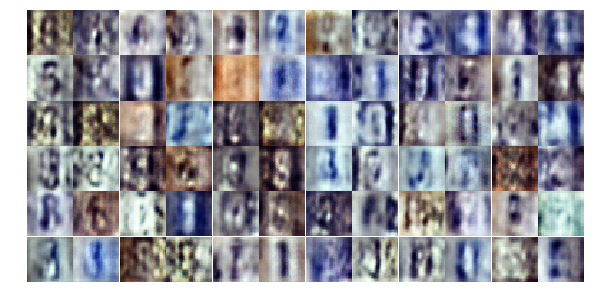

Epoch 2/25... Discriminator Loss: 0.5805... Generator Loss: 1.5333
Epoch 2/25... Discriminator Loss: 0.7603... Generator Loss: 0.9318
Epoch 2/25... Discriminator Loss: 0.6337... Generator Loss: 1.4081
Epoch 2/25... Discriminator Loss: 1.2262... Generator Loss: 0.6922
Epoch 3/25... Discriminator Loss: 0.3745... Generator Loss: 2.5443
Epoch 3/25... Discriminator Loss: 0.8296... Generator Loss: 1.4943
Epoch 3/25... Discriminator Loss: 0.6296... Generator Loss: 1.2578
Epoch 3/25... Discriminator Loss: 0.8332... Generator Loss: 0.8422
Epoch 3/25... Discriminator Loss: 0.7064... Generator Loss: 1.6609
Epoch 3/25... Discriminator Loss: 0.3696... Generator Loss: 1.8572


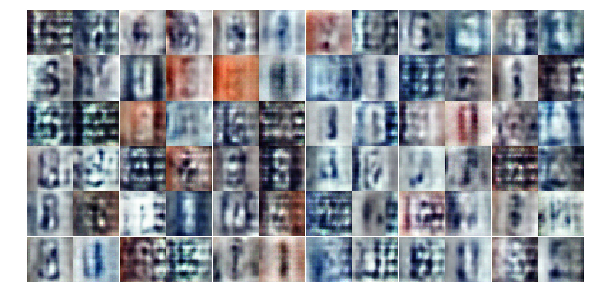

Epoch 3/25... Discriminator Loss: 1.0222... Generator Loss: 2.2601
Epoch 3/25... Discriminator Loss: 0.8269... Generator Loss: 0.9900
Epoch 3/25... Discriminator Loss: 0.4364... Generator Loss: 1.6481
Epoch 3/25... Discriminator Loss: 0.6606... Generator Loss: 1.2929
Epoch 3/25... Discriminator Loss: 0.7492... Generator Loss: 1.5332
Epoch 3/25... Discriminator Loss: 0.8566... Generator Loss: 0.7891
Epoch 3/25... Discriminator Loss: 0.9385... Generator Loss: 0.9944
Epoch 3/25... Discriminator Loss: 0.3989... Generator Loss: 2.3624
Epoch 3/25... Discriminator Loss: 0.2613... Generator Loss: 2.4607
Epoch 3/25... Discriminator Loss: 0.6560... Generator Loss: 1.7426


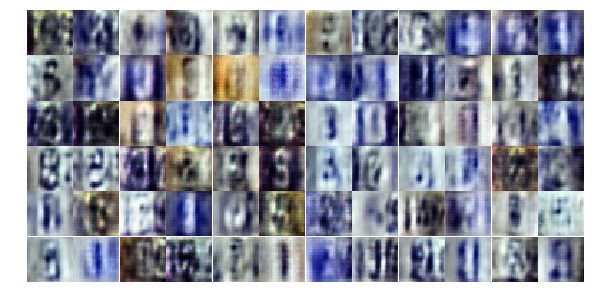

Epoch 3/25... Discriminator Loss: 0.5032... Generator Loss: 1.5040
Epoch 3/25... Discriminator Loss: 0.6201... Generator Loss: 1.2609
Epoch 3/25... Discriminator Loss: 0.4212... Generator Loss: 2.0708
Epoch 3/25... Discriminator Loss: 0.4881... Generator Loss: 2.1070
Epoch 3/25... Discriminator Loss: 0.8818... Generator Loss: 4.8607
Epoch 3/25... Discriminator Loss: 0.6511... Generator Loss: 1.8877
Epoch 3/25... Discriminator Loss: 1.0469... Generator Loss: 0.6680
Epoch 3/25... Discriminator Loss: 1.0076... Generator Loss: 2.4376
Epoch 3/25... Discriminator Loss: 0.3804... Generator Loss: 2.5981
Epoch 3/25... Discriminator Loss: 0.5199... Generator Loss: 1.6052


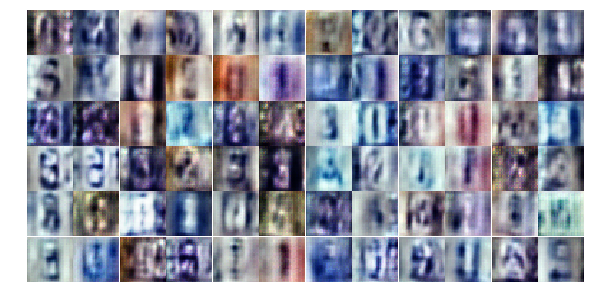

Epoch 3/25... Discriminator Loss: 0.3931... Generator Loss: 1.8180
Epoch 3/25... Discriminator Loss: 0.7741... Generator Loss: 0.8916
Epoch 3/25... Discriminator Loss: 1.5718... Generator Loss: 0.3500
Epoch 3/25... Discriminator Loss: 0.5602... Generator Loss: 2.5187
Epoch 3/25... Discriminator Loss: 0.7113... Generator Loss: 1.8392
Epoch 3/25... Discriminator Loss: 0.6399... Generator Loss: 1.4911
Epoch 3/25... Discriminator Loss: 0.7274... Generator Loss: 0.9836
Epoch 3/25... Discriminator Loss: 0.6893... Generator Loss: 1.3343
Epoch 3/25... Discriminator Loss: 0.5546... Generator Loss: 2.2293
Epoch 3/25... Discriminator Loss: 0.5124... Generator Loss: 1.3912


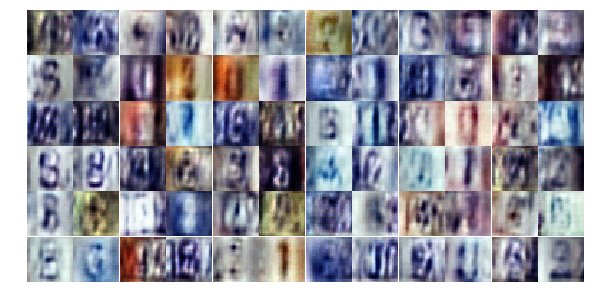

Epoch 3/25... Discriminator Loss: 0.9663... Generator Loss: 1.1213
Epoch 3/25... Discriminator Loss: 0.4648... Generator Loss: 2.2424
Epoch 3/25... Discriminator Loss: 0.5325... Generator Loss: 1.6649
Epoch 3/25... Discriminator Loss: 0.5784... Generator Loss: 1.6449
Epoch 3/25... Discriminator Loss: 0.5487... Generator Loss: 2.5697
Epoch 3/25... Discriminator Loss: 1.2372... Generator Loss: 3.3885
Epoch 3/25... Discriminator Loss: 0.4310... Generator Loss: 1.6441
Epoch 3/25... Discriminator Loss: 1.0344... Generator Loss: 0.6659
Epoch 3/25... Discriminator Loss: 0.6190... Generator Loss: 1.8165
Epoch 3/25... Discriminator Loss: 0.7005... Generator Loss: 1.1144


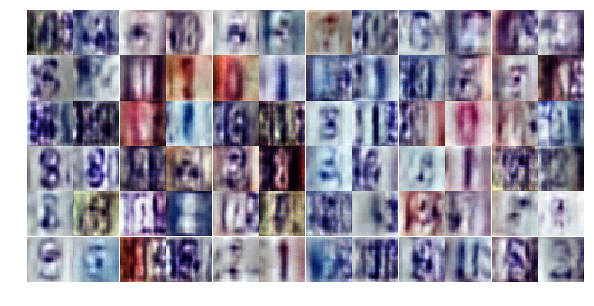

Epoch 3/25... Discriminator Loss: 0.4911... Generator Loss: 1.5536
Epoch 3/25... Discriminator Loss: 0.5400... Generator Loss: 1.4986
Epoch 3/25... Discriminator Loss: 0.6707... Generator Loss: 1.0045
Epoch 3/25... Discriminator Loss: 0.6962... Generator Loss: 1.1543
Epoch 3/25... Discriminator Loss: 0.5930... Generator Loss: 1.2699
Epoch 3/25... Discriminator Loss: 0.3475... Generator Loss: 2.8825
Epoch 3/25... Discriminator Loss: 0.5105... Generator Loss: 2.3672
Epoch 3/25... Discriminator Loss: 0.3875... Generator Loss: 1.9124
Epoch 3/25... Discriminator Loss: 0.3321... Generator Loss: 2.0331
Epoch 3/25... Discriminator Loss: 0.2520... Generator Loss: 2.6760


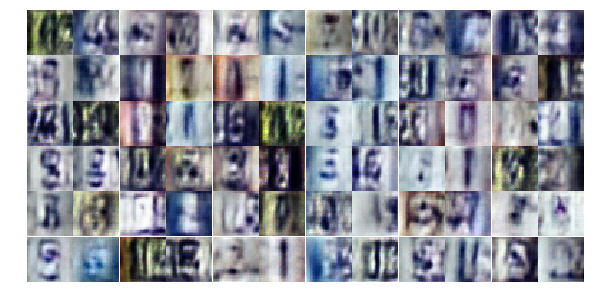

Epoch 3/25... Discriminator Loss: 1.2209... Generator Loss: 0.6953
Epoch 4/25... Discriminator Loss: 0.6717... Generator Loss: 2.3922
Epoch 4/25... Discriminator Loss: 0.3761... Generator Loss: 1.9060
Epoch 4/25... Discriminator Loss: 0.3258... Generator Loss: 2.1586
Epoch 4/25... Discriminator Loss: 0.3023... Generator Loss: 2.8884
Epoch 4/25... Discriminator Loss: 0.3502... Generator Loss: 2.4355
Epoch 4/25... Discriminator Loss: 0.4786... Generator Loss: 3.7051
Epoch 4/25... Discriminator Loss: 2.0856... Generator Loss: 0.2192
Epoch 4/25... Discriminator Loss: 0.7909... Generator Loss: 0.9255
Epoch 4/25... Discriminator Loss: 0.3556... Generator Loss: 2.1976


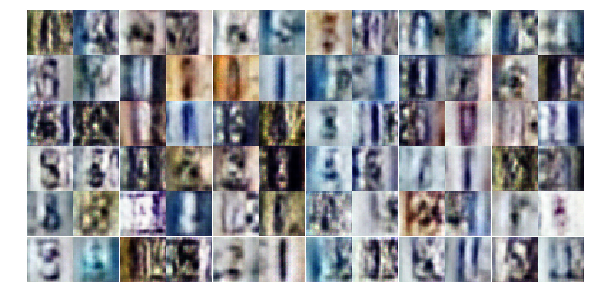

Epoch 4/25... Discriminator Loss: 0.4566... Generator Loss: 1.6795
Epoch 4/25... Discriminator Loss: 0.2933... Generator Loss: 2.0118
Epoch 4/25... Discriminator Loss: 0.3718... Generator Loss: 1.8880
Epoch 4/25... Discriminator Loss: 1.2056... Generator Loss: 4.2518
Epoch 4/25... Discriminator Loss: 1.1156... Generator Loss: 2.8273
Epoch 4/25... Discriminator Loss: 0.5734... Generator Loss: 2.5120
Epoch 4/25... Discriminator Loss: 1.2564... Generator Loss: 0.5189
Epoch 4/25... Discriminator Loss: 0.4856... Generator Loss: 1.3989
Epoch 4/25... Discriminator Loss: 0.4806... Generator Loss: 1.8499
Epoch 4/25... Discriminator Loss: 0.3355... Generator Loss: 2.1178


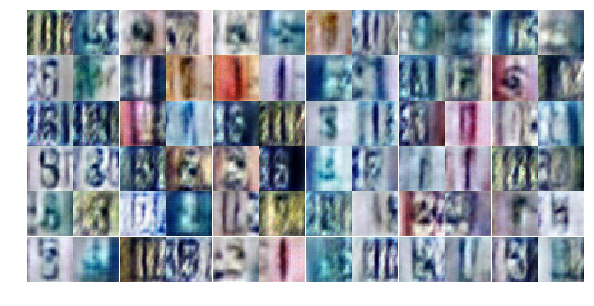

Epoch 4/25... Discriminator Loss: 0.7266... Generator Loss: 1.2512
Epoch 4/25... Discriminator Loss: 0.5750... Generator Loss: 1.2713
Epoch 4/25... Discriminator Loss: 0.2992... Generator Loss: 1.9196
Epoch 4/25... Discriminator Loss: 0.4844... Generator Loss: 2.7009
Epoch 4/25... Discriminator Loss: 0.3397... Generator Loss: 2.2300
Epoch 4/25... Discriminator Loss: 1.0952... Generator Loss: 4.5413
Epoch 4/25... Discriminator Loss: 1.0057... Generator Loss: 0.6420
Epoch 4/25... Discriminator Loss: 0.8340... Generator Loss: 0.8359
Epoch 4/25... Discriminator Loss: 0.3108... Generator Loss: 2.1791
Epoch 4/25... Discriminator Loss: 0.4568... Generator Loss: 1.4772


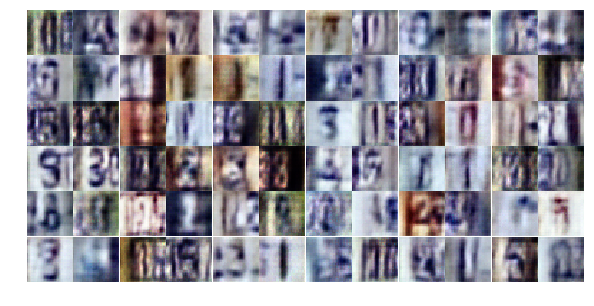

Epoch 4/25... Discriminator Loss: 0.3410... Generator Loss: 1.9946
Epoch 4/25... Discriminator Loss: 0.5449... Generator Loss: 1.3382
Epoch 4/25... Discriminator Loss: 0.5714... Generator Loss: 1.1664
Epoch 4/25... Discriminator Loss: 0.3177... Generator Loss: 1.9042
Epoch 4/25... Discriminator Loss: 0.5105... Generator Loss: 3.8984
Epoch 4/25... Discriminator Loss: 0.4927... Generator Loss: 1.7839
Epoch 4/25... Discriminator Loss: 0.6290... Generator Loss: 1.2453
Epoch 4/25... Discriminator Loss: 0.6542... Generator Loss: 1.0460
Epoch 4/25... Discriminator Loss: 1.5191... Generator Loss: 0.3479
Epoch 4/25... Discriminator Loss: 0.4448... Generator Loss: 2.0836


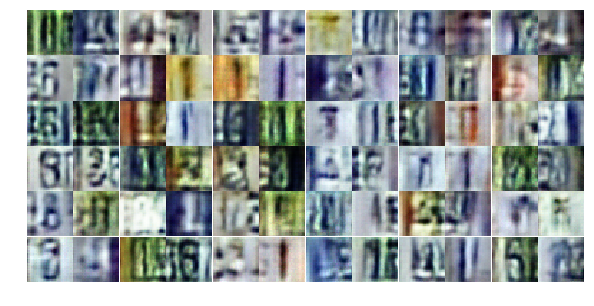

Epoch 4/25... Discriminator Loss: 0.3720... Generator Loss: 1.6875
Epoch 4/25... Discriminator Loss: 0.4912... Generator Loss: 1.3486
Epoch 4/25... Discriminator Loss: 1.2116... Generator Loss: 0.4818
Epoch 4/25... Discriminator Loss: 0.4280... Generator Loss: 2.0523
Epoch 4/25... Discriminator Loss: 0.3024... Generator Loss: 2.1771
Epoch 4/25... Discriminator Loss: 0.5699... Generator Loss: 1.1214
Epoch 4/25... Discriminator Loss: 0.7068... Generator Loss: 1.0287
Epoch 4/25... Discriminator Loss: 0.7227... Generator Loss: 3.4302
Epoch 4/25... Discriminator Loss: 0.4468... Generator Loss: 2.1730
Epoch 4/25... Discriminator Loss: 0.3282... Generator Loss: 1.9176


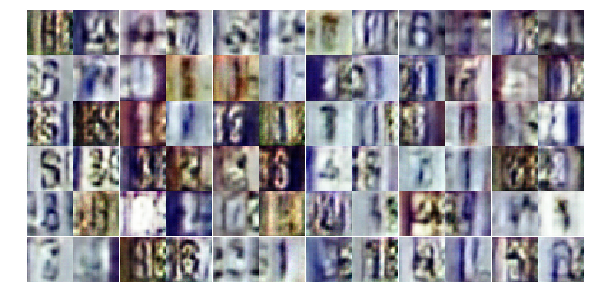

Epoch 4/25... Discriminator Loss: 1.6757... Generator Loss: 0.3287
Epoch 4/25... Discriminator Loss: 0.6639... Generator Loss: 2.4577
Epoch 4/25... Discriminator Loss: 0.3841... Generator Loss: 1.9391
Epoch 4/25... Discriminator Loss: 0.3339... Generator Loss: 2.5089
Epoch 4/25... Discriminator Loss: 0.3756... Generator Loss: 1.7305
Epoch 4/25... Discriminator Loss: 0.5721... Generator Loss: 3.0049
Epoch 4/25... Discriminator Loss: 0.4288... Generator Loss: 1.9084
Epoch 4/25... Discriminator Loss: 0.5822... Generator Loss: 1.6692
Epoch 4/25... Discriminator Loss: 0.5007... Generator Loss: 2.4584
Epoch 5/25... Discriminator Loss: 0.6851... Generator Loss: 2.9814


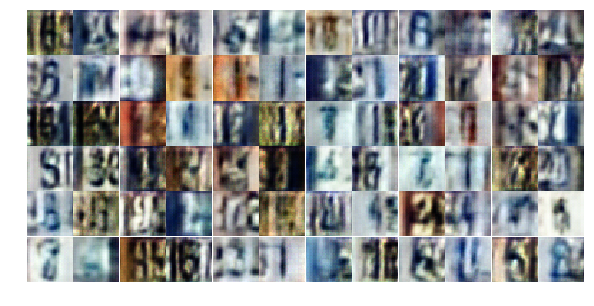

Epoch 5/25... Discriminator Loss: 0.6650... Generator Loss: 1.3947
Epoch 5/25... Discriminator Loss: 0.3976... Generator Loss: 1.8162
Epoch 5/25... Discriminator Loss: 0.5520... Generator Loss: 1.2952
Epoch 5/25... Discriminator Loss: 0.2319... Generator Loss: 2.0550
Epoch 5/25... Discriminator Loss: 0.2808... Generator Loss: 3.2264
Epoch 5/25... Discriminator Loss: 1.0331... Generator Loss: 0.5782
Epoch 5/25... Discriminator Loss: 1.2842... Generator Loss: 0.4877
Epoch 5/25... Discriminator Loss: 0.4595... Generator Loss: 1.5846
Epoch 5/25... Discriminator Loss: 0.4162... Generator Loss: 1.5080
Epoch 5/25... Discriminator Loss: 1.9274... Generator Loss: 0.2909


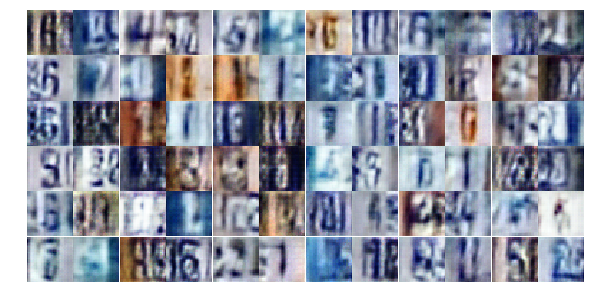

Epoch 5/25... Discriminator Loss: 1.4988... Generator Loss: 0.5408
Epoch 5/25... Discriminator Loss: 0.6827... Generator Loss: 1.1192
Epoch 5/25... Discriminator Loss: 0.3979... Generator Loss: 1.8620
Epoch 5/25... Discriminator Loss: 1.3570... Generator Loss: 0.4519
Epoch 5/25... Discriminator Loss: 0.4843... Generator Loss: 2.0443
Epoch 5/25... Discriminator Loss: 0.5695... Generator Loss: 1.2954
Epoch 5/25... Discriminator Loss: 0.5502... Generator Loss: 1.2330
Epoch 5/25... Discriminator Loss: 0.5231... Generator Loss: 1.4072
Epoch 5/25... Discriminator Loss: 0.3461... Generator Loss: 1.6034
Epoch 5/25... Discriminator Loss: 0.4723... Generator Loss: 1.5123


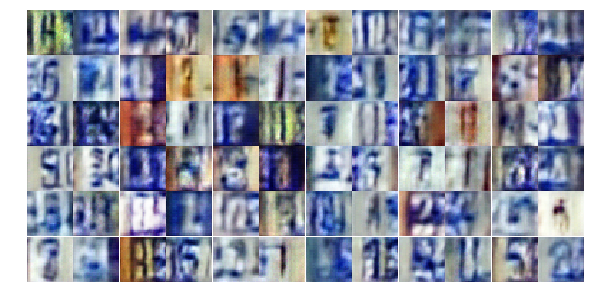

Epoch 5/25... Discriminator Loss: 0.4044... Generator Loss: 1.4836
Epoch 5/25... Discriminator Loss: 0.6779... Generator Loss: 1.0248
Epoch 5/25... Discriminator Loss: 0.7972... Generator Loss: 0.8289
Epoch 5/25... Discriminator Loss: 0.7263... Generator Loss: 1.0857
Epoch 5/25... Discriminator Loss: 1.5450... Generator Loss: 0.4659
Epoch 5/25... Discriminator Loss: 0.6973... Generator Loss: 1.2167
Epoch 5/25... Discriminator Loss: 1.4715... Generator Loss: 0.4123
Epoch 5/25... Discriminator Loss: 0.8445... Generator Loss: 0.8998
Epoch 5/25... Discriminator Loss: 0.8061... Generator Loss: 0.8018
Epoch 5/25... Discriminator Loss: 0.2724... Generator Loss: 2.3713


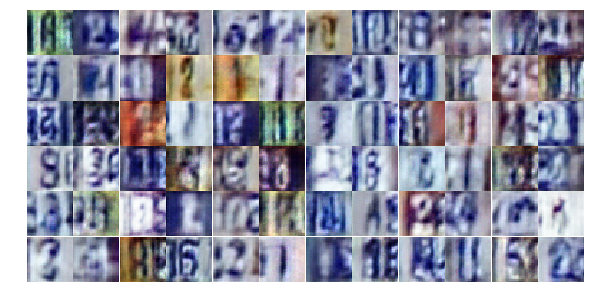

Epoch 5/25... Discriminator Loss: 0.4477... Generator Loss: 1.8531
Epoch 5/25... Discriminator Loss: 0.4482... Generator Loss: 1.5419
Epoch 5/25... Discriminator Loss: 0.5600... Generator Loss: 2.2160
Epoch 5/25... Discriminator Loss: 0.4450... Generator Loss: 1.3282
Epoch 5/25... Discriminator Loss: 0.7307... Generator Loss: 0.9589
Epoch 5/25... Discriminator Loss: 0.3667... Generator Loss: 1.8651
Epoch 5/25... Discriminator Loss: 0.3914... Generator Loss: 1.7436
Epoch 5/25... Discriminator Loss: 0.4295... Generator Loss: 1.4298
Epoch 5/25... Discriminator Loss: 0.9190... Generator Loss: 0.7157
Epoch 5/25... Discriminator Loss: 0.4382... Generator Loss: 1.6246


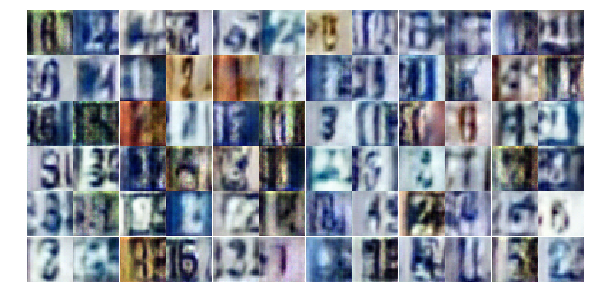

Epoch 5/25... Discriminator Loss: 0.4965... Generator Loss: 3.6050
Epoch 5/25... Discriminator Loss: 0.4614... Generator Loss: 1.8814
Epoch 5/25... Discriminator Loss: 1.5667... Generator Loss: 0.5812
Epoch 5/25... Discriminator Loss: 0.5507... Generator Loss: 2.0838
Epoch 5/25... Discriminator Loss: 0.4221... Generator Loss: 2.1563
Epoch 5/25... Discriminator Loss: 0.6806... Generator Loss: 1.0676
Epoch 5/25... Discriminator Loss: 0.5242... Generator Loss: 1.2885
Epoch 5/25... Discriminator Loss: 0.4114... Generator Loss: 1.5586
Epoch 5/25... Discriminator Loss: 0.5123... Generator Loss: 1.3558
Epoch 5/25... Discriminator Loss: 0.3117... Generator Loss: 2.0009


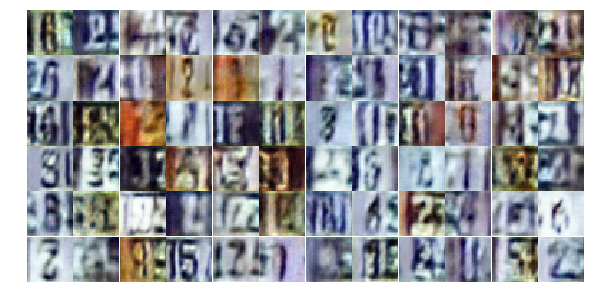

Epoch 5/25... Discriminator Loss: 1.4542... Generator Loss: 4.3305
Epoch 5/25... Discriminator Loss: 0.5735... Generator Loss: 1.3745
Epoch 5/25... Discriminator Loss: 0.5094... Generator Loss: 1.7740
Epoch 5/25... Discriminator Loss: 0.8521... Generator Loss: 0.8115
Epoch 5/25... Discriminator Loss: 0.3342... Generator Loss: 1.7272
Epoch 5/25... Discriminator Loss: 0.4662... Generator Loss: 1.9551
Epoch 6/25... Discriminator Loss: 0.4178... Generator Loss: 1.5888
Epoch 6/25... Discriminator Loss: 0.4469... Generator Loss: 1.9196
Epoch 6/25... Discriminator Loss: 0.9813... Generator Loss: 3.6137
Epoch 6/25... Discriminator Loss: 0.5251... Generator Loss: 1.2871


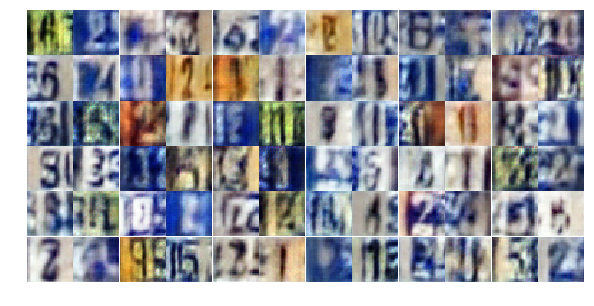

Epoch 6/25... Discriminator Loss: 0.2999... Generator Loss: 2.0241
Epoch 6/25... Discriminator Loss: 0.5989... Generator Loss: 1.4402
Epoch 6/25... Discriminator Loss: 0.7180... Generator Loss: 0.9172
Epoch 6/25... Discriminator Loss: 1.0533... Generator Loss: 0.6202
Epoch 6/25... Discriminator Loss: 0.7937... Generator Loss: 0.8372
Epoch 6/25... Discriminator Loss: 0.3319... Generator Loss: 1.7038
Epoch 6/25... Discriminator Loss: 0.3092... Generator Loss: 1.9321
Epoch 6/25... Discriminator Loss: 1.0436... Generator Loss: 0.5994
Epoch 6/25... Discriminator Loss: 0.6303... Generator Loss: 1.0540
Epoch 6/25... Discriminator Loss: 1.4832... Generator Loss: 0.5836


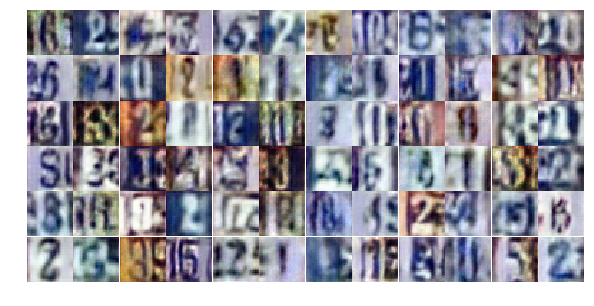

Epoch 6/25... Discriminator Loss: 2.8681... Generator Loss: 3.8598
Epoch 6/25... Discriminator Loss: 0.7255... Generator Loss: 1.0658
Epoch 6/25... Discriminator Loss: 0.6164... Generator Loss: 1.6713
Epoch 6/25... Discriminator Loss: 0.7472... Generator Loss: 1.0878
Epoch 6/25... Discriminator Loss: 0.3919... Generator Loss: 1.6830
Epoch 6/25... Discriminator Loss: 0.2885... Generator Loss: 2.0998
Epoch 6/25... Discriminator Loss: 0.4122... Generator Loss: 1.5948
Epoch 6/25... Discriminator Loss: 0.7626... Generator Loss: 0.9156
Epoch 6/25... Discriminator Loss: 0.3020... Generator Loss: 1.9098
Epoch 6/25... Discriminator Loss: 0.7935... Generator Loss: 0.8126


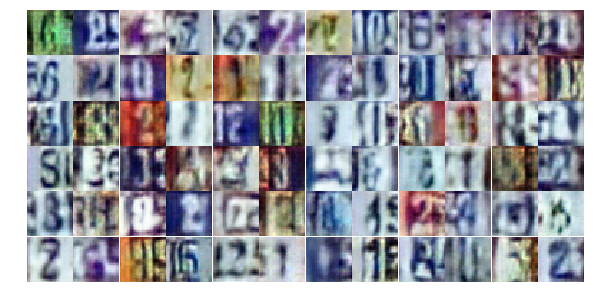

Epoch 6/25... Discriminator Loss: 1.1245... Generator Loss: 0.5514
Epoch 6/25... Discriminator Loss: 0.6103... Generator Loss: 1.1230
Epoch 6/25... Discriminator Loss: 0.4821... Generator Loss: 1.4411
Epoch 6/25... Discriminator Loss: 0.7837... Generator Loss: 0.8733
Epoch 6/25... Discriminator Loss: 0.6223... Generator Loss: 2.6763
Epoch 6/25... Discriminator Loss: 1.2419... Generator Loss: 0.5108
Epoch 6/25... Discriminator Loss: 1.1009... Generator Loss: 0.6531
Epoch 6/25... Discriminator Loss: 0.4471... Generator Loss: 1.4781
Epoch 6/25... Discriminator Loss: 0.3923... Generator Loss: 1.8720
Epoch 6/25... Discriminator Loss: 0.3419... Generator Loss: 2.4501


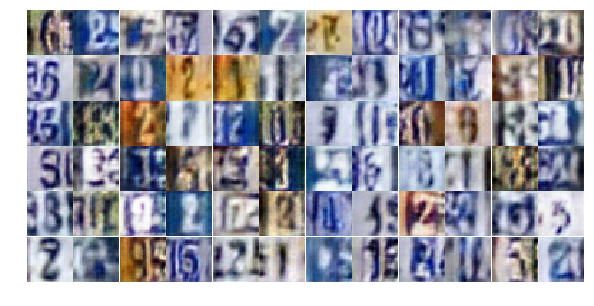

Epoch 6/25... Discriminator Loss: 0.7023... Generator Loss: 1.4121
Epoch 6/25... Discriminator Loss: 0.4515... Generator Loss: 1.6340
Epoch 6/25... Discriminator Loss: 0.3765... Generator Loss: 1.6506
Epoch 6/25... Discriminator Loss: 0.5524... Generator Loss: 1.2056
Epoch 6/25... Discriminator Loss: 0.4779... Generator Loss: 2.0069
Epoch 6/25... Discriminator Loss: 0.4612... Generator Loss: 1.3500
Epoch 6/25... Discriminator Loss: 0.3023... Generator Loss: 2.0534
Epoch 6/25... Discriminator Loss: 0.3892... Generator Loss: 2.1284
Epoch 6/25... Discriminator Loss: 0.4354... Generator Loss: 1.4818
Epoch 6/25... Discriminator Loss: 0.5778... Generator Loss: 1.1217


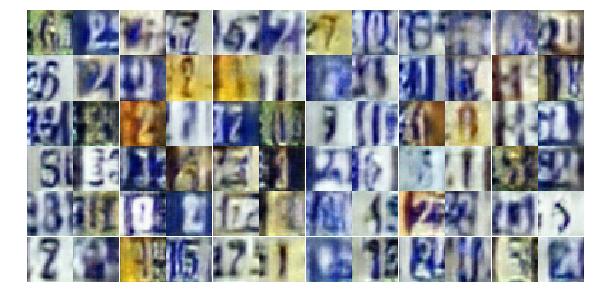

Epoch 6/25... Discriminator Loss: 1.0309... Generator Loss: 0.8349
Epoch 6/25... Discriminator Loss: 1.2877... Generator Loss: 0.5230
Epoch 6/25... Discriminator Loss: 2.2274... Generator Loss: 0.1891
Epoch 6/25... Discriminator Loss: 0.6249... Generator Loss: 1.5801
Epoch 6/25... Discriminator Loss: 0.6261... Generator Loss: 2.7124
Epoch 6/25... Discriminator Loss: 0.5354... Generator Loss: 1.3152
Epoch 6/25... Discriminator Loss: 0.6094... Generator Loss: 1.5821
Epoch 6/25... Discriminator Loss: 1.3142... Generator Loss: 0.4763
Epoch 6/25... Discriminator Loss: 0.5942... Generator Loss: 1.3898
Epoch 6/25... Discriminator Loss: 1.4903... Generator Loss: 0.3759


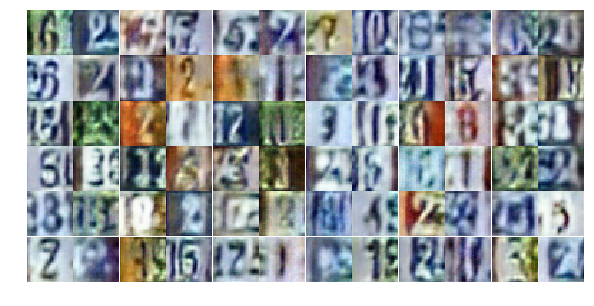

Epoch 6/25... Discriminator Loss: 0.4268... Generator Loss: 1.5385
Epoch 6/25... Discriminator Loss: 0.5875... Generator Loss: 1.1205
Epoch 6/25... Discriminator Loss: 0.3454... Generator Loss: 1.8169
Epoch 7/25... Discriminator Loss: 0.3816... Generator Loss: 1.7964
Epoch 7/25... Discriminator Loss: 0.5415... Generator Loss: 1.2818
Epoch 7/25... Discriminator Loss: 0.3766... Generator Loss: 1.7963
Epoch 7/25... Discriminator Loss: 0.2614... Generator Loss: 2.1592
Epoch 7/25... Discriminator Loss: 0.2387... Generator Loss: 2.3245
Epoch 7/25... Discriminator Loss: 0.4092... Generator Loss: 3.4224
Epoch 7/25... Discriminator Loss: 1.1155... Generator Loss: 2.4727


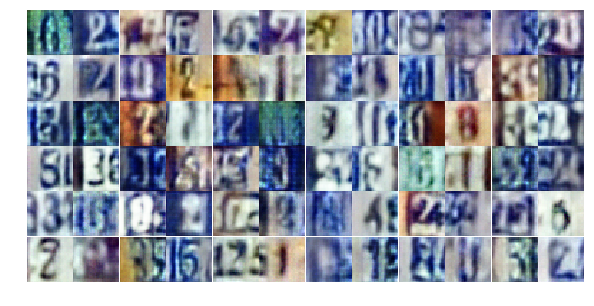

Epoch 7/25... Discriminator Loss: 0.4797... Generator Loss: 2.2430
Epoch 7/25... Discriminator Loss: 0.7454... Generator Loss: 0.9991
Epoch 7/25... Discriminator Loss: 0.6527... Generator Loss: 1.0155
Epoch 7/25... Discriminator Loss: 0.6539... Generator Loss: 2.7182
Epoch 7/25... Discriminator Loss: 0.4159... Generator Loss: 1.5404
Epoch 7/25... Discriminator Loss: 0.4987... Generator Loss: 1.2454
Epoch 7/25... Discriminator Loss: 0.6567... Generator Loss: 2.3358
Epoch 7/25... Discriminator Loss: 0.4383... Generator Loss: 1.6825
Epoch 7/25... Discriminator Loss: 0.5174... Generator Loss: 2.6800
Epoch 7/25... Discriminator Loss: 0.3048... Generator Loss: 2.0711


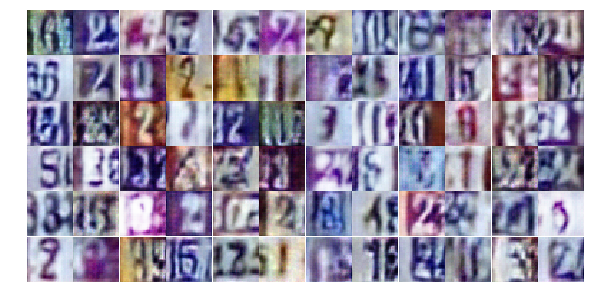

Epoch 7/25... Discriminator Loss: 1.1136... Generator Loss: 0.6418
Epoch 7/25... Discriminator Loss: 1.1679... Generator Loss: 0.7466
Epoch 7/25... Discriminator Loss: 1.0363... Generator Loss: 0.6447
Epoch 7/25... Discriminator Loss: 0.4468... Generator Loss: 2.0042
Epoch 7/25... Discriminator Loss: 0.3121... Generator Loss: 1.8902
Epoch 7/25... Discriminator Loss: 0.4895... Generator Loss: 1.2603
Epoch 7/25... Discriminator Loss: 0.4374... Generator Loss: 1.4861
Epoch 7/25... Discriminator Loss: 0.6472... Generator Loss: 1.1989
Epoch 7/25... Discriminator Loss: 0.2057... Generator Loss: 2.8873
Epoch 7/25... Discriminator Loss: 0.3129... Generator Loss: 2.8883


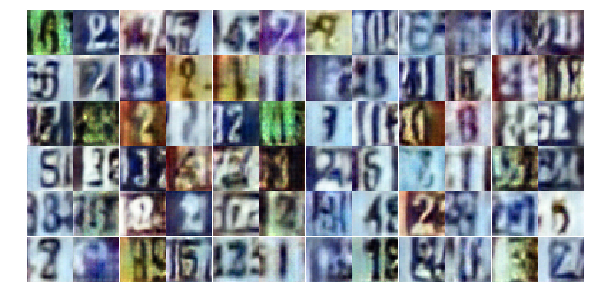

Epoch 7/25... Discriminator Loss: 0.3420... Generator Loss: 1.9958
Epoch 7/25... Discriminator Loss: 0.5356... Generator Loss: 1.1727
Epoch 7/25... Discriminator Loss: 0.3398... Generator Loss: 1.7551
Epoch 7/25... Discriminator Loss: 0.8316... Generator Loss: 0.9751
Epoch 7/25... Discriminator Loss: 0.8613... Generator Loss: 0.8279
Epoch 7/25... Discriminator Loss: 0.4671... Generator Loss: 1.5010
Epoch 7/25... Discriminator Loss: 0.3838... Generator Loss: 1.7950
Epoch 7/25... Discriminator Loss: 0.6284... Generator Loss: 1.1124
Epoch 7/25... Discriminator Loss: 1.3170... Generator Loss: 0.4458
Epoch 7/25... Discriminator Loss: 0.3612... Generator Loss: 2.9557


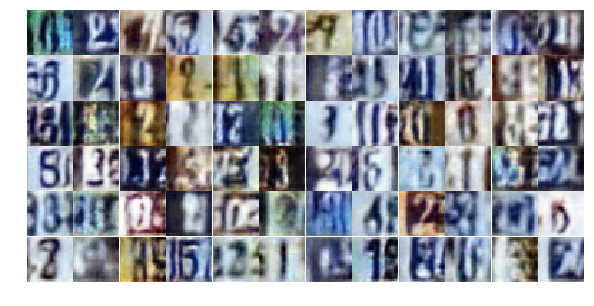

Epoch 7/25... Discriminator Loss: 1.2400... Generator Loss: 0.4698
Epoch 7/25... Discriminator Loss: 0.9405... Generator Loss: 1.4275
Epoch 7/25... Discriminator Loss: 0.6790... Generator Loss: 3.2690
Epoch 7/25... Discriminator Loss: 0.5118... Generator Loss: 2.0489
Epoch 7/25... Discriminator Loss: 0.6624... Generator Loss: 1.0075
Epoch 7/25... Discriminator Loss: 0.3158... Generator Loss: 2.4012
Epoch 7/25... Discriminator Loss: 0.5322... Generator Loss: 1.2899
Epoch 7/25... Discriminator Loss: 0.9908... Generator Loss: 2.5425
Epoch 7/25... Discriminator Loss: 0.2121... Generator Loss: 2.2882
Epoch 7/25... Discriminator Loss: 1.2001... Generator Loss: 0.6673


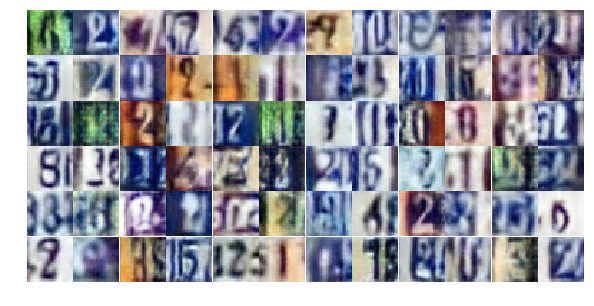

Epoch 7/25... Discriminator Loss: 0.6665... Generator Loss: 3.6574
Epoch 7/25... Discriminator Loss: 0.5665... Generator Loss: 1.1649
Epoch 7/25... Discriminator Loss: 0.5093... Generator Loss: 1.2526
Epoch 7/25... Discriminator Loss: 0.5004... Generator Loss: 1.2962
Epoch 7/25... Discriminator Loss: 0.4331... Generator Loss: 1.6176
Epoch 7/25... Discriminator Loss: 1.1945... Generator Loss: 0.5902
Epoch 7/25... Discriminator Loss: 0.9236... Generator Loss: 0.7511
Epoch 7/25... Discriminator Loss: 1.0526... Generator Loss: 0.6355
Epoch 7/25... Discriminator Loss: 0.6406... Generator Loss: 1.3983
Epoch 7/25... Discriminator Loss: 0.4326... Generator Loss: 1.4323


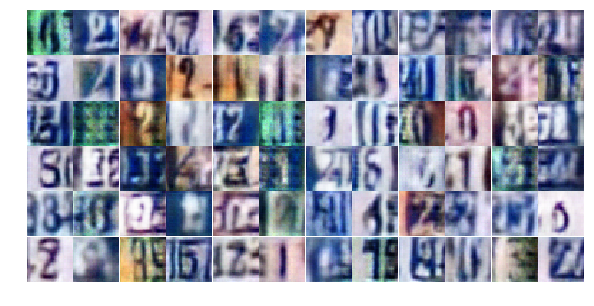

Epoch 7/25... Discriminator Loss: 0.5476... Generator Loss: 1.8796
Epoch 8/25... Discriminator Loss: 0.3466... Generator Loss: 1.9139
Epoch 8/25... Discriminator Loss: 0.6567... Generator Loss: 0.9877
Epoch 8/25... Discriminator Loss: 0.3809... Generator Loss: 1.6563
Epoch 8/25... Discriminator Loss: 0.3859... Generator Loss: 1.6044
Epoch 8/25... Discriminator Loss: 0.8857... Generator Loss: 0.7228
Epoch 8/25... Discriminator Loss: 0.8053... Generator Loss: 0.8669
Epoch 8/25... Discriminator Loss: 2.6109... Generator Loss: 6.3757
Epoch 8/25... Discriminator Loss: 0.9599... Generator Loss: 1.0131
Epoch 8/25... Discriminator Loss: 0.7827... Generator Loss: 0.9701


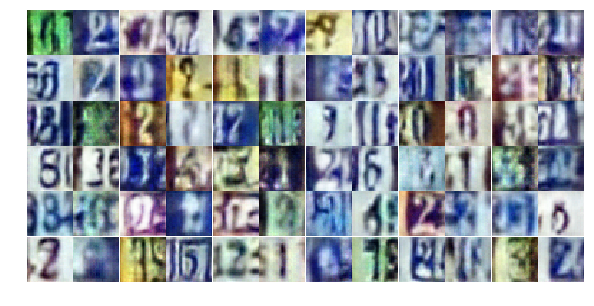

Epoch 8/25... Discriminator Loss: 0.4801... Generator Loss: 1.9031
Epoch 8/25... Discriminator Loss: 0.4522... Generator Loss: 1.3771
Epoch 8/25... Discriminator Loss: 0.6566... Generator Loss: 1.0618
Epoch 8/25... Discriminator Loss: 0.3167... Generator Loss: 1.8539
Epoch 8/25... Discriminator Loss: 0.6255... Generator Loss: 1.1290
Epoch 8/25... Discriminator Loss: 0.7734... Generator Loss: 3.8520
Epoch 8/25... Discriminator Loss: 0.4915... Generator Loss: 1.4234
Epoch 8/25... Discriminator Loss: 0.4210... Generator Loss: 2.0527
Epoch 8/25... Discriminator Loss: 0.5062... Generator Loss: 1.5154
Epoch 8/25... Discriminator Loss: 1.1289... Generator Loss: 0.5515


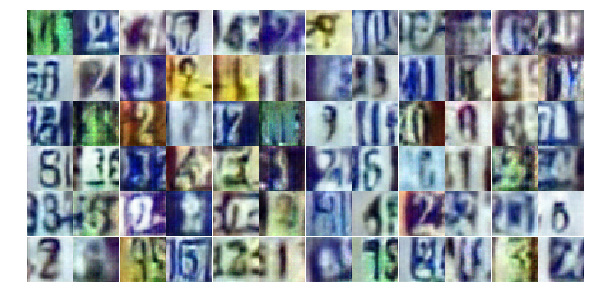

Epoch 8/25... Discriminator Loss: 0.3803... Generator Loss: 2.4638
Epoch 8/25... Discriminator Loss: 0.4752... Generator Loss: 1.3369
Epoch 8/25... Discriminator Loss: 0.7796... Generator Loss: 0.8255
Epoch 8/25... Discriminator Loss: 0.6275... Generator Loss: 2.8441
Epoch 8/25... Discriminator Loss: 0.4072... Generator Loss: 1.9937
Epoch 8/25... Discriminator Loss: 0.3915... Generator Loss: 1.5583
Epoch 8/25... Discriminator Loss: 0.4934... Generator Loss: 1.7693
Epoch 8/25... Discriminator Loss: 0.3169... Generator Loss: 1.8700
Epoch 8/25... Discriminator Loss: 0.7978... Generator Loss: 3.1094
Epoch 8/25... Discriminator Loss: 0.5742... Generator Loss: 2.0239


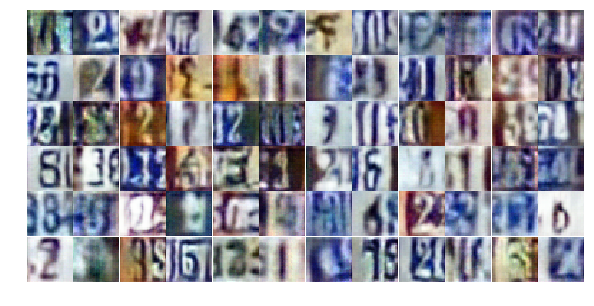

Epoch 8/25... Discriminator Loss: 0.6666... Generator Loss: 1.1095
Epoch 8/25... Discriminator Loss: 0.3914... Generator Loss: 1.6076
Epoch 8/25... Discriminator Loss: 0.5643... Generator Loss: 1.2354
Epoch 8/25... Discriminator Loss: 0.7048... Generator Loss: 1.0206
Epoch 8/25... Discriminator Loss: 0.7258... Generator Loss: 1.0217
Epoch 8/25... Discriminator Loss: 0.5366... Generator Loss: 1.2758
Epoch 8/25... Discriminator Loss: 0.3804... Generator Loss: 1.6433
Epoch 8/25... Discriminator Loss: 0.4925... Generator Loss: 1.2997
Epoch 8/25... Discriminator Loss: 0.5226... Generator Loss: 1.2396
Epoch 8/25... Discriminator Loss: 0.6394... Generator Loss: 1.0547


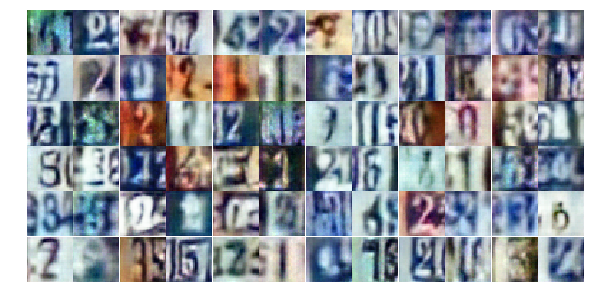

Epoch 8/25... Discriminator Loss: 0.3395... Generator Loss: 1.7287
Epoch 8/25... Discriminator Loss: 0.9186... Generator Loss: 0.6898
Epoch 8/25... Discriminator Loss: 0.2768... Generator Loss: 1.8354
Epoch 8/25... Discriminator Loss: 0.3301... Generator Loss: 1.7428
Epoch 8/25... Discriminator Loss: 0.8125... Generator Loss: 2.6519
Epoch 8/25... Discriminator Loss: 0.4130... Generator Loss: 1.4903
Epoch 8/25... Discriminator Loss: 0.7500... Generator Loss: 0.8844
Epoch 8/25... Discriminator Loss: 0.5922... Generator Loss: 1.2338
Epoch 8/25... Discriminator Loss: 0.4371... Generator Loss: 1.5806
Epoch 8/25... Discriminator Loss: 0.3209... Generator Loss: 2.0475


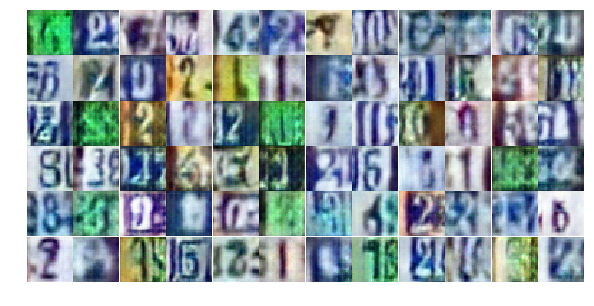

Epoch 8/25... Discriminator Loss: 0.4192... Generator Loss: 1.6385
Epoch 8/25... Discriminator Loss: 0.3127... Generator Loss: 1.9714
Epoch 8/25... Discriminator Loss: 0.3376... Generator Loss: 3.3445
Epoch 8/25... Discriminator Loss: 0.3893... Generator Loss: 2.2806
Epoch 8/25... Discriminator Loss: 0.3817... Generator Loss: 4.0245
Epoch 8/25... Discriminator Loss: 0.9441... Generator Loss: 0.6742
Epoch 8/25... Discriminator Loss: 0.5290... Generator Loss: 1.1457
Epoch 8/25... Discriminator Loss: 0.3593... Generator Loss: 2.4515
Epoch 9/25... Discriminator Loss: 0.7112... Generator Loss: 2.3846
Epoch 9/25... Discriminator Loss: 0.4972... Generator Loss: 1.2381


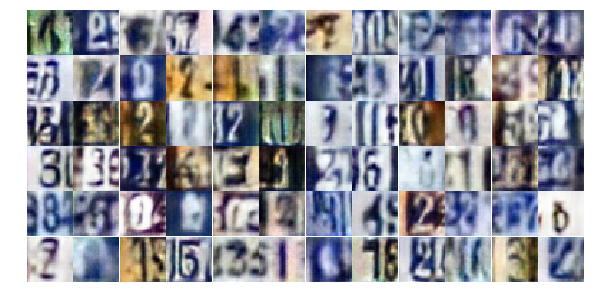

Epoch 9/25... Discriminator Loss: 0.5789... Generator Loss: 1.1424
Epoch 9/25... Discriminator Loss: 0.3733... Generator Loss: 1.8505
Epoch 9/25... Discriminator Loss: 0.9842... Generator Loss: 0.6778
Epoch 9/25... Discriminator Loss: 0.1846... Generator Loss: 3.0262
Epoch 9/25... Discriminator Loss: 3.0275... Generator Loss: 0.1051
Epoch 9/25... Discriminator Loss: 1.5421... Generator Loss: 3.4418
Epoch 9/25... Discriminator Loss: 1.0485... Generator Loss: 0.6545
Epoch 9/25... Discriminator Loss: 0.5465... Generator Loss: 1.2227
Epoch 9/25... Discriminator Loss: 0.8285... Generator Loss: 0.9762
Epoch 9/25... Discriminator Loss: 0.6739... Generator Loss: 1.0608


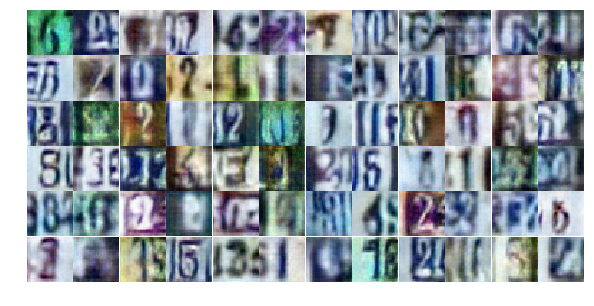

Epoch 9/25... Discriminator Loss: 1.1800... Generator Loss: 0.5180
Epoch 9/25... Discriminator Loss: 0.8521... Generator Loss: 0.8176
Epoch 9/25... Discriminator Loss: 0.4773... Generator Loss: 1.4338
Epoch 9/25... Discriminator Loss: 0.6066... Generator Loss: 1.2534
Epoch 9/25... Discriminator Loss: 0.4464... Generator Loss: 1.4803
Epoch 9/25... Discriminator Loss: 0.7867... Generator Loss: 1.0754
Epoch 9/25... Discriminator Loss: 0.9699... Generator Loss: 0.7817
Epoch 9/25... Discriminator Loss: 0.5053... Generator Loss: 1.2997
Epoch 9/25... Discriminator Loss: 0.8486... Generator Loss: 0.8026
Epoch 9/25... Discriminator Loss: 1.0454... Generator Loss: 0.6086


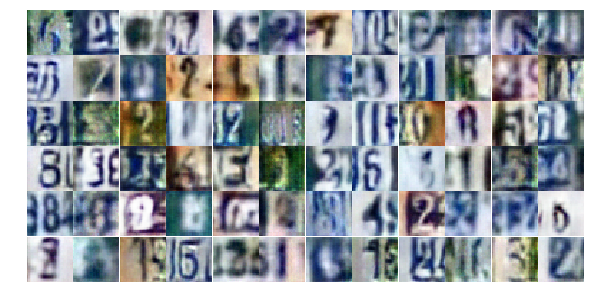

Epoch 9/25... Discriminator Loss: 0.6153... Generator Loss: 1.1724
Epoch 9/25... Discriminator Loss: 0.7155... Generator Loss: 0.9314
Epoch 9/25... Discriminator Loss: 0.5136... Generator Loss: 1.4048
Epoch 9/25... Discriminator Loss: 0.3773... Generator Loss: 1.6844
Epoch 9/25... Discriminator Loss: 0.2837... Generator Loss: 2.5923
Epoch 9/25... Discriminator Loss: 0.3843... Generator Loss: 1.6864
Epoch 9/25... Discriminator Loss: 4.1159... Generator Loss: 0.0444
Epoch 9/25... Discriminator Loss: 1.0022... Generator Loss: 2.3609
Epoch 9/25... Discriminator Loss: 0.5115... Generator Loss: 2.1278
Epoch 9/25... Discriminator Loss: 0.7883... Generator Loss: 0.8541


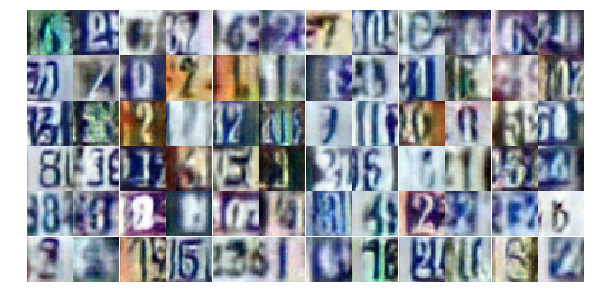

Epoch 9/25... Discriminator Loss: 0.4692... Generator Loss: 1.4040
Epoch 9/25... Discriminator Loss: 0.4444... Generator Loss: 1.5577
Epoch 9/25... Discriminator Loss: 0.9490... Generator Loss: 0.7385
Epoch 9/25... Discriminator Loss: 0.5389... Generator Loss: 1.9066
Epoch 9/25... Discriminator Loss: 0.5868... Generator Loss: 2.2213
Epoch 9/25... Discriminator Loss: 0.6860... Generator Loss: 1.9171
Epoch 9/25... Discriminator Loss: 0.3504... Generator Loss: 2.0637
Epoch 9/25... Discriminator Loss: 0.3352... Generator Loss: 1.7173
Epoch 9/25... Discriminator Loss: 0.7094... Generator Loss: 1.0072
Epoch 9/25... Discriminator Loss: 0.3964... Generator Loss: 1.5510


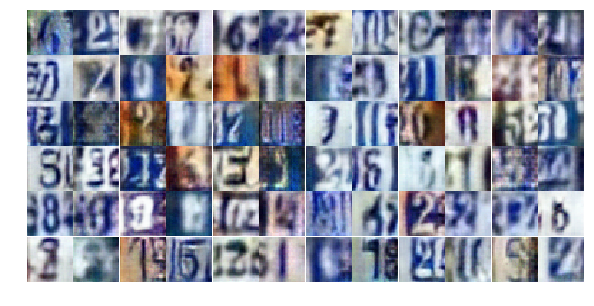

Epoch 9/25... Discriminator Loss: 0.8906... Generator Loss: 0.7534
Epoch 9/25... Discriminator Loss: 0.4719... Generator Loss: 1.3082
Epoch 9/25... Discriminator Loss: 0.3592... Generator Loss: 1.9925
Epoch 9/25... Discriminator Loss: 0.6742... Generator Loss: 1.0385
Epoch 9/25... Discriminator Loss: 0.2713... Generator Loss: 2.9331
Epoch 9/25... Discriminator Loss: 0.5030... Generator Loss: 1.4749
Epoch 9/25... Discriminator Loss: 0.5605... Generator Loss: 1.3125
Epoch 9/25... Discriminator Loss: 0.8002... Generator Loss: 0.8045
Epoch 9/25... Discriminator Loss: 0.4731... Generator Loss: 1.5150
Epoch 9/25... Discriminator Loss: 0.5867... Generator Loss: 3.3656


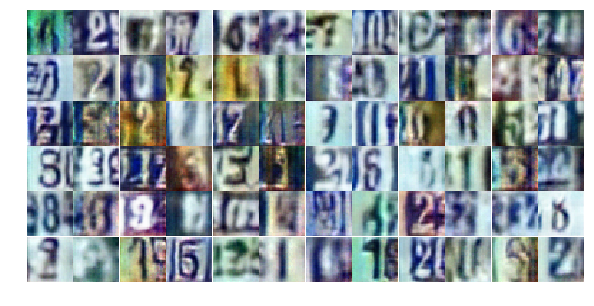

Epoch 9/25... Discriminator Loss: 1.9112... Generator Loss: 0.2754
Epoch 9/25... Discriminator Loss: 1.9279... Generator Loss: 5.5108
Epoch 9/25... Discriminator Loss: 1.1106... Generator Loss: 0.7226
Epoch 9/25... Discriminator Loss: 0.7975... Generator Loss: 0.8262
Epoch 9/25... Discriminator Loss: 0.5134... Generator Loss: 1.2634
Epoch 10/25... Discriminator Loss: 0.3221... Generator Loss: 2.4826
Epoch 10/25... Discriminator Loss: 0.5199... Generator Loss: 1.5335
Epoch 10/25... Discriminator Loss: 0.2368... Generator Loss: 2.1840
Epoch 10/25... Discriminator Loss: 0.8683... Generator Loss: 0.8304
Epoch 10/25... Discriminator Loss: 1.2054... Generator Loss: 0.5535


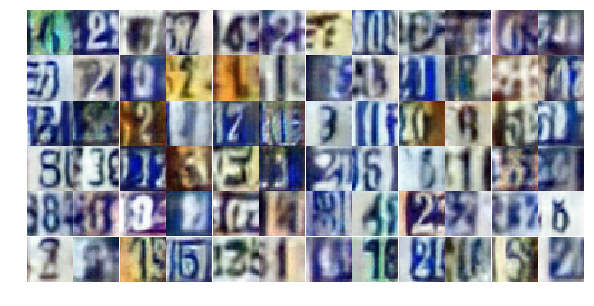

Epoch 10/25... Discriminator Loss: 0.8498... Generator Loss: 0.8726
Epoch 10/25... Discriminator Loss: 0.2823... Generator Loss: 2.8571
Epoch 10/25... Discriminator Loss: 0.9322... Generator Loss: 0.7873
Epoch 10/25... Discriminator Loss: 0.4719... Generator Loss: 1.4770
Epoch 10/25... Discriminator Loss: 0.4111... Generator Loss: 1.6863
Epoch 10/25... Discriminator Loss: 0.4145... Generator Loss: 2.1109
Epoch 10/25... Discriminator Loss: 0.3770... Generator Loss: 1.5168
Epoch 10/25... Discriminator Loss: 1.7923... Generator Loss: 0.2690
Epoch 10/25... Discriminator Loss: 2.8141... Generator Loss: 0.1651
Epoch 10/25... Discriminator Loss: 1.0544... Generator Loss: 1.7967


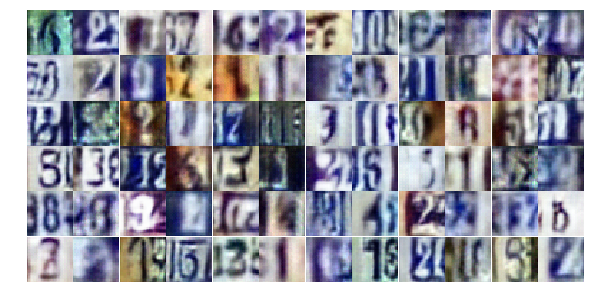

Epoch 10/25... Discriminator Loss: 0.4796... Generator Loss: 2.3461
Epoch 10/25... Discriminator Loss: 0.6281... Generator Loss: 1.1413
Epoch 10/25... Discriminator Loss: 1.8671... Generator Loss: 4.9065
Epoch 10/25... Discriminator Loss: 1.3082... Generator Loss: 0.5829
Epoch 10/25... Discriminator Loss: 0.6705... Generator Loss: 1.0001
Epoch 10/25... Discriminator Loss: 0.5007... Generator Loss: 1.4147
Epoch 10/25... Discriminator Loss: 0.5809... Generator Loss: 1.2234
Epoch 10/25... Discriminator Loss: 0.4367... Generator Loss: 1.4193
Epoch 10/25... Discriminator Loss: 0.5897... Generator Loss: 1.1504
Epoch 10/25... Discriminator Loss: 0.2634... Generator Loss: 2.4881


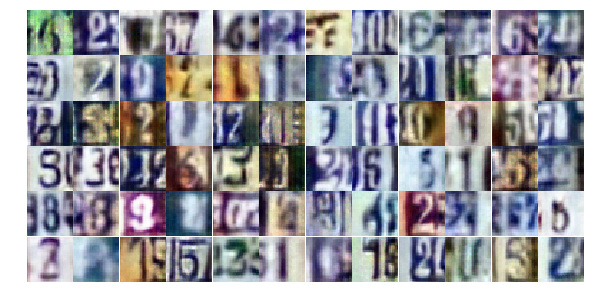

Epoch 10/25... Discriminator Loss: 1.0965... Generator Loss: 0.6374
Epoch 10/25... Discriminator Loss: 0.5180... Generator Loss: 1.3742
Epoch 10/25... Discriminator Loss: 0.3144... Generator Loss: 1.7946
Epoch 10/25... Discriminator Loss: 0.3240... Generator Loss: 2.0159
Epoch 10/25... Discriminator Loss: 1.4944... Generator Loss: 0.3908
Epoch 10/25... Discriminator Loss: 0.5557... Generator Loss: 1.2783
Epoch 10/25... Discriminator Loss: 0.3646... Generator Loss: 1.5471
Epoch 10/25... Discriminator Loss: 0.5042... Generator Loss: 1.7939
Epoch 10/25... Discriminator Loss: 0.3142... Generator Loss: 1.7203
Epoch 10/25... Discriminator Loss: 0.6366... Generator Loss: 1.1207


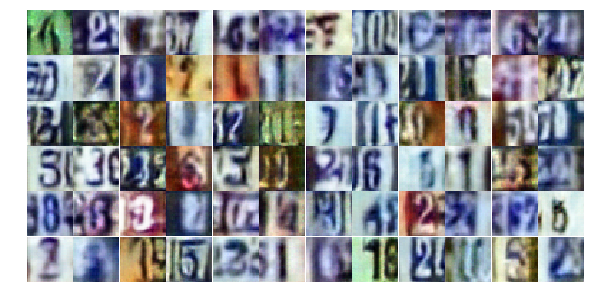

Epoch 10/25... Discriminator Loss: 0.7532... Generator Loss: 3.1325
Epoch 10/25... Discriminator Loss: 1.0366... Generator Loss: 0.7664
Epoch 10/25... Discriminator Loss: 0.3305... Generator Loss: 2.2559
Epoch 10/25... Discriminator Loss: 0.6385... Generator Loss: 2.8318
Epoch 10/25... Discriminator Loss: 0.6560... Generator Loss: 0.9680
Epoch 10/25... Discriminator Loss: 1.0251... Generator Loss: 0.6794
Epoch 10/25... Discriminator Loss: 0.6588... Generator Loss: 1.0665
Epoch 10/25... Discriminator Loss: 0.9612... Generator Loss: 0.8364
Epoch 10/25... Discriminator Loss: 0.6391... Generator Loss: 1.0588
Epoch 10/25... Discriminator Loss: 0.4568... Generator Loss: 2.6770


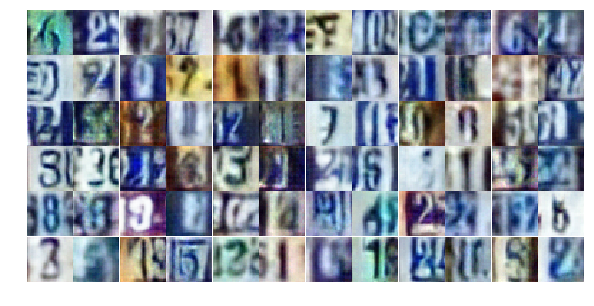

Epoch 10/25... Discriminator Loss: 0.4607... Generator Loss: 1.4220
Epoch 10/25... Discriminator Loss: 0.7371... Generator Loss: 3.0208
Epoch 10/25... Discriminator Loss: 1.6605... Generator Loss: 0.3584
Epoch 10/25... Discriminator Loss: 0.6609... Generator Loss: 1.1127
Epoch 10/25... Discriminator Loss: 0.4127... Generator Loss: 2.1050
Epoch 10/25... Discriminator Loss: 0.5817... Generator Loss: 1.8616
Epoch 10/25... Discriminator Loss: 0.3640... Generator Loss: 1.6948
Epoch 10/25... Discriminator Loss: 0.3912... Generator Loss: 1.6329
Epoch 10/25... Discriminator Loss: 0.3229... Generator Loss: 2.2248
Epoch 10/25... Discriminator Loss: 0.4258... Generator Loss: 1.6038


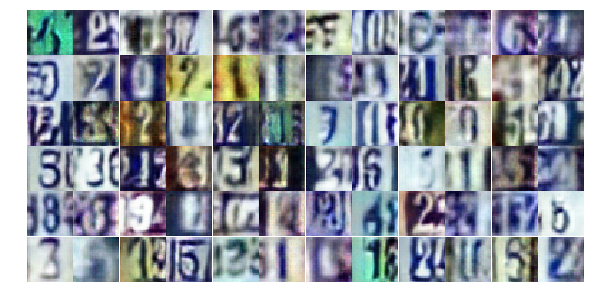

Epoch 10/25... Discriminator Loss: 0.6600... Generator Loss: 1.2064
Epoch 10/25... Discriminator Loss: 0.6021... Generator Loss: 1.1895
Epoch 10/25... Discriminator Loss: 0.4109... Generator Loss: 1.8550
Epoch 11/25... Discriminator Loss: 0.5471... Generator Loss: 1.6418
Epoch 11/25... Discriminator Loss: 0.4798... Generator Loss: 1.3117
Epoch 11/25... Discriminator Loss: 1.4389... Generator Loss: 0.4041
Epoch 11/25... Discriminator Loss: 0.5473... Generator Loss: 1.1206
Epoch 11/25... Discriminator Loss: 0.4680... Generator Loss: 1.6684
Epoch 11/25... Discriminator Loss: 2.1624... Generator Loss: 0.2192
Epoch 11/25... Discriminator Loss: 0.5227... Generator Loss: 1.5223


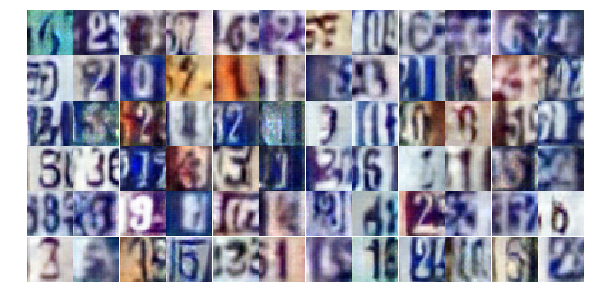

Epoch 11/25... Discriminator Loss: 0.2813... Generator Loss: 1.9780
Epoch 11/25... Discriminator Loss: 0.5049... Generator Loss: 1.8964
Epoch 11/25... Discriminator Loss: 0.5209... Generator Loss: 1.2977
Epoch 11/25... Discriminator Loss: 0.6447... Generator Loss: 1.0203
Epoch 11/25... Discriminator Loss: 0.6819... Generator Loss: 0.9213
Epoch 11/25... Discriminator Loss: 0.3564... Generator Loss: 1.9139
Epoch 11/25... Discriminator Loss: 0.7648... Generator Loss: 1.2847
Epoch 11/25... Discriminator Loss: 0.3262... Generator Loss: 2.9690
Epoch 11/25... Discriminator Loss: 0.7918... Generator Loss: 0.8721
Epoch 11/25... Discriminator Loss: 1.2547... Generator Loss: 0.5578


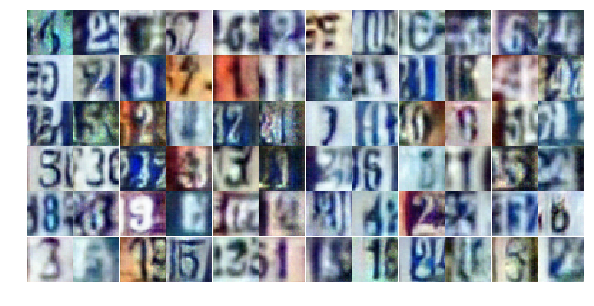

Epoch 11/25... Discriminator Loss: 0.8659... Generator Loss: 0.7601
Epoch 11/25... Discriminator Loss: 0.3973... Generator Loss: 1.7205
Epoch 11/25... Discriminator Loss: 0.6771... Generator Loss: 1.0561
Epoch 11/25... Discriminator Loss: 0.7902... Generator Loss: 0.7894
Epoch 11/25... Discriminator Loss: 0.3120... Generator Loss: 2.7764
Epoch 11/25... Discriminator Loss: 0.2990... Generator Loss: 2.3178
Epoch 11/25... Discriminator Loss: 0.4775... Generator Loss: 1.2978
Epoch 11/25... Discriminator Loss: 0.7617... Generator Loss: 0.9874
Epoch 11/25... Discriminator Loss: 0.4678... Generator Loss: 1.3529
Epoch 11/25... Discriminator Loss: 0.5770... Generator Loss: 1.1951


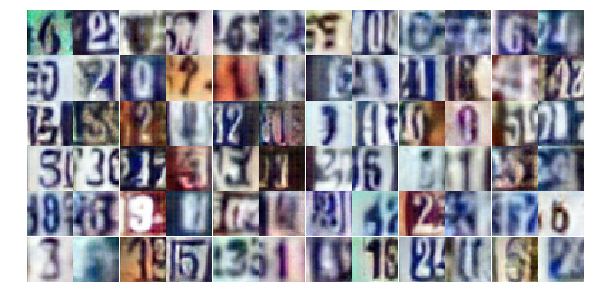

Epoch 11/25... Discriminator Loss: 0.3528... Generator Loss: 2.0312
Epoch 11/25... Discriminator Loss: 0.5255... Generator Loss: 1.7880
Epoch 11/25... Discriminator Loss: 0.6287... Generator Loss: 1.0569
Epoch 11/25... Discriminator Loss: 0.5309... Generator Loss: 1.1625
Epoch 11/25... Discriminator Loss: 0.5793... Generator Loss: 1.1819
Epoch 11/25... Discriminator Loss: 1.1313... Generator Loss: 0.5491
Epoch 11/25... Discriminator Loss: 0.7763... Generator Loss: 2.9804
Epoch 11/25... Discriminator Loss: 0.8004... Generator Loss: 0.9262
Epoch 11/25... Discriminator Loss: 0.4542... Generator Loss: 1.5314
Epoch 11/25... Discriminator Loss: 1.1415... Generator Loss: 0.5911


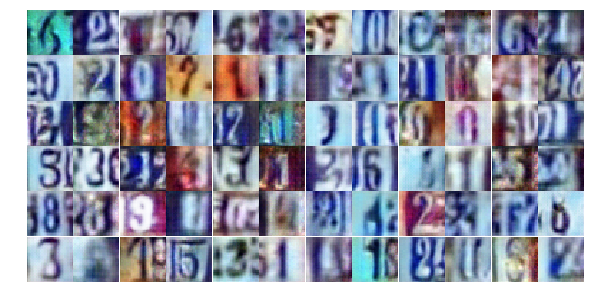

Epoch 11/25... Discriminator Loss: 0.4211... Generator Loss: 1.5175
Epoch 11/25... Discriminator Loss: 0.5406... Generator Loss: 1.3213
Epoch 11/25... Discriminator Loss: 0.9354... Generator Loss: 0.6982
Epoch 11/25... Discriminator Loss: 0.3993... Generator Loss: 1.7816
Epoch 11/25... Discriminator Loss: 0.9128... Generator Loss: 0.7007
Epoch 11/25... Discriminator Loss: 0.5456... Generator Loss: 1.0928
Epoch 11/25... Discriminator Loss: 0.9002... Generator Loss: 0.8663
Epoch 11/25... Discriminator Loss: 0.7415... Generator Loss: 0.9458
Epoch 11/25... Discriminator Loss: 1.2572... Generator Loss: 0.4570
Epoch 11/25... Discriminator Loss: 0.3491... Generator Loss: 2.0494


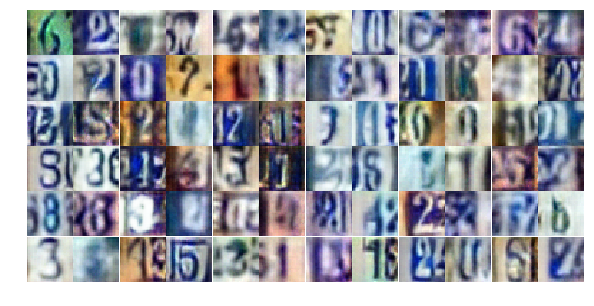

Epoch 11/25... Discriminator Loss: 0.4408... Generator Loss: 1.8634
Epoch 11/25... Discriminator Loss: 0.3249... Generator Loss: 1.8548
Epoch 11/25... Discriminator Loss: 0.4440... Generator Loss: 1.3996
Epoch 11/25... Discriminator Loss: 0.3298... Generator Loss: 1.8558
Epoch 11/25... Discriminator Loss: 1.0071... Generator Loss: 0.6449
Epoch 11/25... Discriminator Loss: 0.7227... Generator Loss: 0.9406
Epoch 11/25... Discriminator Loss: 1.2278... Generator Loss: 0.6578
Epoch 11/25... Discriminator Loss: 0.3217... Generator Loss: 2.1884
Epoch 11/25... Discriminator Loss: 0.5632... Generator Loss: 1.6092
Epoch 11/25... Discriminator Loss: 0.7052... Generator Loss: 1.0376


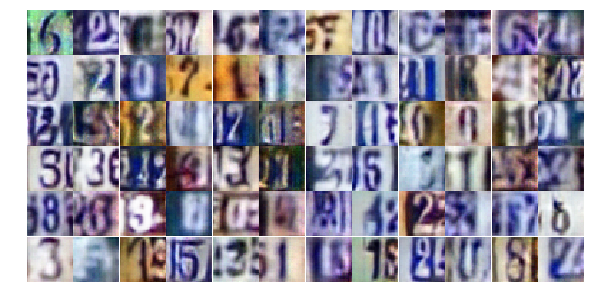

Epoch 12/25... Discriminator Loss: 0.3523... Generator Loss: 1.9189
Epoch 12/25... Discriminator Loss: 0.3637... Generator Loss: 1.6456
Epoch 12/25... Discriminator Loss: 0.5373... Generator Loss: 1.2142
Epoch 12/25... Discriminator Loss: 0.2878... Generator Loss: 1.8930
Epoch 12/25... Discriminator Loss: 0.3315... Generator Loss: 1.6567
Epoch 12/25... Discriminator Loss: 1.0042... Generator Loss: 0.6432
Epoch 12/25... Discriminator Loss: 0.7994... Generator Loss: 3.8909
Epoch 12/25... Discriminator Loss: 4.6289... Generator Loss: 1.9389
Epoch 12/25... Discriminator Loss: 1.2392... Generator Loss: 0.8078
Epoch 12/25... Discriminator Loss: 1.3746... Generator Loss: 0.5675


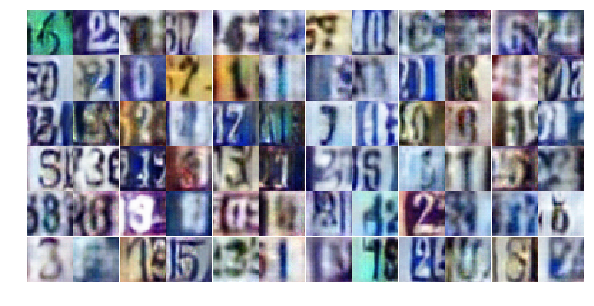

Epoch 12/25... Discriminator Loss: 0.5791... Generator Loss: 1.1860
Epoch 12/25... Discriminator Loss: 0.5160... Generator Loss: 1.6003
Epoch 12/25... Discriminator Loss: 0.4567... Generator Loss: 1.4789
Epoch 12/25... Discriminator Loss: 0.4585... Generator Loss: 1.7247
Epoch 12/25... Discriminator Loss: 0.4018... Generator Loss: 1.7620
Epoch 12/25... Discriminator Loss: 0.6042... Generator Loss: 1.3218
Epoch 12/25... Discriminator Loss: 1.5810... Generator Loss: 0.3890
Epoch 12/25... Discriminator Loss: 0.5276... Generator Loss: 2.3711
Epoch 12/25... Discriminator Loss: 0.5261... Generator Loss: 1.2977
Epoch 12/25... Discriminator Loss: 0.7572... Generator Loss: 0.9053


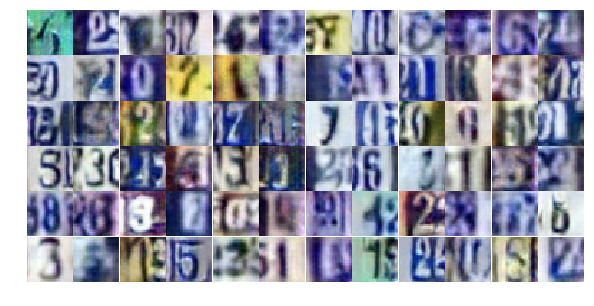

Epoch 12/25... Discriminator Loss: 0.2063... Generator Loss: 2.6878
Epoch 12/25... Discriminator Loss: 0.2998... Generator Loss: 2.2411
Epoch 12/25... Discriminator Loss: 0.5578... Generator Loss: 1.2368
Epoch 12/25... Discriminator Loss: 0.3030... Generator Loss: 1.9702
Epoch 12/25... Discriminator Loss: 0.2565... Generator Loss: 2.2283
Epoch 12/25... Discriminator Loss: 0.3834... Generator Loss: 1.6597
Epoch 12/25... Discriminator Loss: 0.6222... Generator Loss: 1.0999
Epoch 12/25... Discriminator Loss: 0.2669... Generator Loss: 1.9688
Epoch 12/25... Discriminator Loss: 0.5546... Generator Loss: 2.4279
Epoch 12/25... Discriminator Loss: 0.6727... Generator Loss: 1.0817


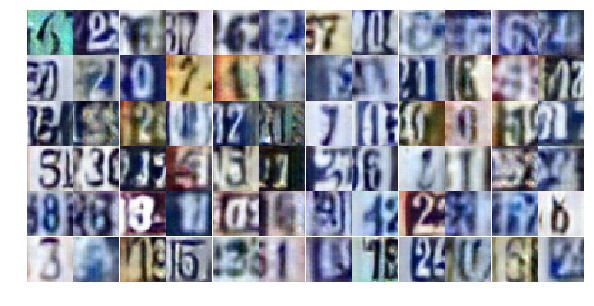

Epoch 12/25... Discriminator Loss: 0.6316... Generator Loss: 1.1338
Epoch 12/25... Discriminator Loss: 0.5997... Generator Loss: 1.2620
Epoch 12/25... Discriminator Loss: 1.1547... Generator Loss: 0.6204
Epoch 12/25... Discriminator Loss: 1.7341... Generator Loss: 0.2943
Epoch 12/25... Discriminator Loss: 0.9058... Generator Loss: 3.4185
Epoch 12/25... Discriminator Loss: 1.0984... Generator Loss: 0.6178
Epoch 12/25... Discriminator Loss: 0.6472... Generator Loss: 1.0538
Epoch 12/25... Discriminator Loss: 0.5335... Generator Loss: 1.3398
Epoch 12/25... Discriminator Loss: 0.4721... Generator Loss: 1.5172
Epoch 12/25... Discriminator Loss: 0.2859... Generator Loss: 1.9816


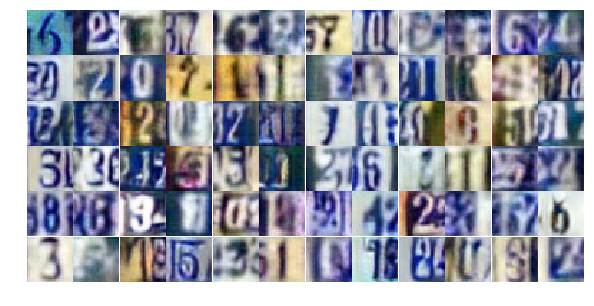

Epoch 12/25... Discriminator Loss: 0.5471... Generator Loss: 1.1303
Epoch 12/25... Discriminator Loss: 0.4409... Generator Loss: 1.2911
Epoch 12/25... Discriminator Loss: 0.4355... Generator Loss: 1.4158
Epoch 12/25... Discriminator Loss: 0.6212... Generator Loss: 2.2698
Epoch 12/25... Discriminator Loss: 1.1106... Generator Loss: 0.9297
Epoch 12/25... Discriminator Loss: 2.0333... Generator Loss: 0.2735
Epoch 12/25... Discriminator Loss: 0.5555... Generator Loss: 1.4736
Epoch 12/25... Discriminator Loss: 1.1715... Generator Loss: 0.5653
Epoch 12/25... Discriminator Loss: 0.4737... Generator Loss: 1.3319
Epoch 12/25... Discriminator Loss: 0.6211... Generator Loss: 1.1058


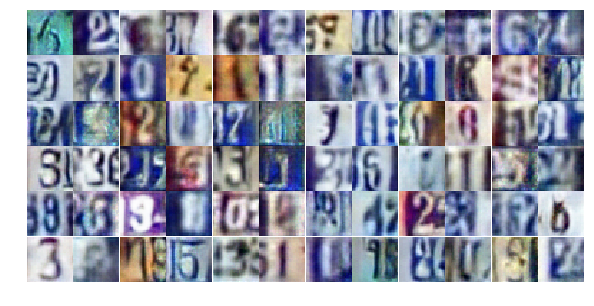

Epoch 12/25... Discriminator Loss: 0.7174... Generator Loss: 1.0655
Epoch 12/25... Discriminator Loss: 0.3634... Generator Loss: 2.0852
Epoch 12/25... Discriminator Loss: 0.5663... Generator Loss: 1.2451
Epoch 12/25... Discriminator Loss: 0.7507... Generator Loss: 0.9895
Epoch 12/25... Discriminator Loss: 0.4480... Generator Loss: 1.4624
Epoch 12/25... Discriminator Loss: 0.8598... Generator Loss: 3.1666
Epoch 12/25... Discriminator Loss: 1.2464... Generator Loss: 0.5888
Epoch 13/25... Discriminator Loss: 0.4185... Generator Loss: 1.6286
Epoch 13/25... Discriminator Loss: 0.3695... Generator Loss: 1.5923
Epoch 13/25... Discriminator Loss: 0.7020... Generator Loss: 0.9568


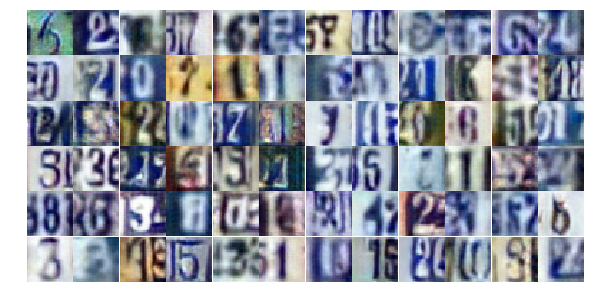

Epoch 13/25... Discriminator Loss: 0.5158... Generator Loss: 1.2940
Epoch 13/25... Discriminator Loss: 0.6952... Generator Loss: 0.9818
Epoch 13/25... Discriminator Loss: 0.6811... Generator Loss: 0.9807
Epoch 13/25... Discriminator Loss: 0.5813... Generator Loss: 1.2298
Epoch 13/25... Discriminator Loss: 0.4291... Generator Loss: 1.5519
Epoch 13/25... Discriminator Loss: 0.3715... Generator Loss: 1.6759
Epoch 13/25... Discriminator Loss: 0.2048... Generator Loss: 3.0601
Epoch 13/25... Discriminator Loss: 0.4694... Generator Loss: 1.2904
Epoch 13/25... Discriminator Loss: 0.3645... Generator Loss: 1.5958
Epoch 13/25... Discriminator Loss: 0.3408... Generator Loss: 1.9750


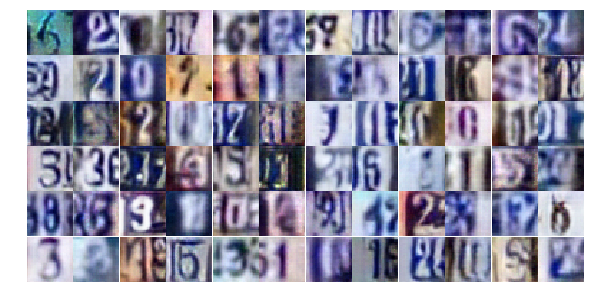

Epoch 13/25... Discriminator Loss: 0.5239... Generator Loss: 1.3261
Epoch 13/25... Discriminator Loss: 0.3122... Generator Loss: 1.8140
Epoch 13/25... Discriminator Loss: 1.2001... Generator Loss: 0.6011
Epoch 13/25... Discriminator Loss: 0.8524... Generator Loss: 0.7805
Epoch 13/25... Discriminator Loss: 0.5428... Generator Loss: 1.4261
Epoch 13/25... Discriminator Loss: 1.6940... Generator Loss: 0.3451
Epoch 13/25... Discriminator Loss: 0.7443... Generator Loss: 1.0482
Epoch 13/25... Discriminator Loss: 1.0179... Generator Loss: 0.6939
Epoch 13/25... Discriminator Loss: 0.5847... Generator Loss: 1.2376
Epoch 13/25... Discriminator Loss: 1.1734... Generator Loss: 0.5653


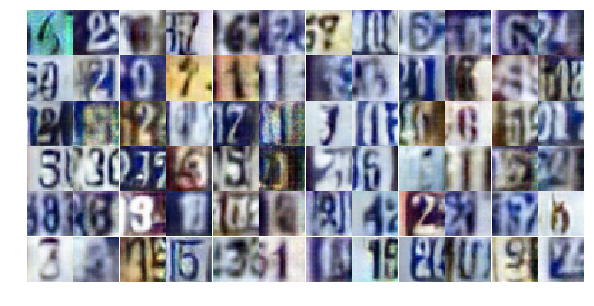

Epoch 13/25... Discriminator Loss: 0.5366... Generator Loss: 1.2111
Epoch 13/25... Discriminator Loss: 0.4278... Generator Loss: 2.0195
Epoch 13/25... Discriminator Loss: 0.3948... Generator Loss: 2.1844
Epoch 13/25... Discriminator Loss: 0.6048... Generator Loss: 1.0966
Epoch 13/25... Discriminator Loss: 0.5003... Generator Loss: 1.3279
Epoch 13/25... Discriminator Loss: 0.4932... Generator Loss: 1.3442
Epoch 13/25... Discriminator Loss: 0.4796... Generator Loss: 2.6802
Epoch 13/25... Discriminator Loss: 0.4417... Generator Loss: 1.5086
Epoch 13/25... Discriminator Loss: 0.4399... Generator Loss: 1.5178
Epoch 13/25... Discriminator Loss: 0.3893... Generator Loss: 1.7145


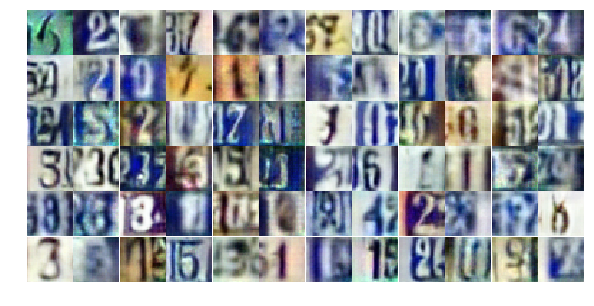

Epoch 13/25... Discriminator Loss: 1.1721... Generator Loss: 0.5492
Epoch 13/25... Discriminator Loss: 1.6386... Generator Loss: 2.3834
Epoch 13/25... Discriminator Loss: 1.4052... Generator Loss: 0.8413
Epoch 13/25... Discriminator Loss: 1.0427... Generator Loss: 0.8121
Epoch 13/25... Discriminator Loss: 0.4058... Generator Loss: 1.9128
Epoch 13/25... Discriminator Loss: 0.3936... Generator Loss: 1.9090
Epoch 13/25... Discriminator Loss: 0.4829... Generator Loss: 1.4065
Epoch 13/25... Discriminator Loss: 0.8132... Generator Loss: 0.8687
Epoch 13/25... Discriminator Loss: 0.3912... Generator Loss: 2.1491
Epoch 13/25... Discriminator Loss: 1.0837... Generator Loss: 0.5719


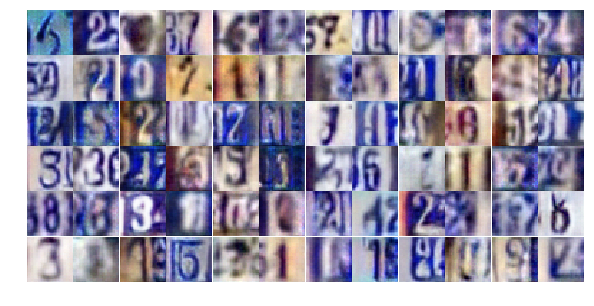

Epoch 13/25... Discriminator Loss: 0.4752... Generator Loss: 1.5900
Epoch 13/25... Discriminator Loss: 1.1585... Generator Loss: 0.6103
Epoch 13/25... Discriminator Loss: 0.7613... Generator Loss: 1.0104
Epoch 13/25... Discriminator Loss: 0.5826... Generator Loss: 1.1205
Epoch 13/25... Discriminator Loss: 0.9287... Generator Loss: 0.7048
Epoch 13/25... Discriminator Loss: 0.4924... Generator Loss: 1.4816
Epoch 13/25... Discriminator Loss: 0.6035... Generator Loss: 1.1590
Epoch 13/25... Discriminator Loss: 0.4916... Generator Loss: 1.6691
Epoch 13/25... Discriminator Loss: 0.6738... Generator Loss: 1.0400
Epoch 13/25... Discriminator Loss: 0.5053... Generator Loss: 1.3260


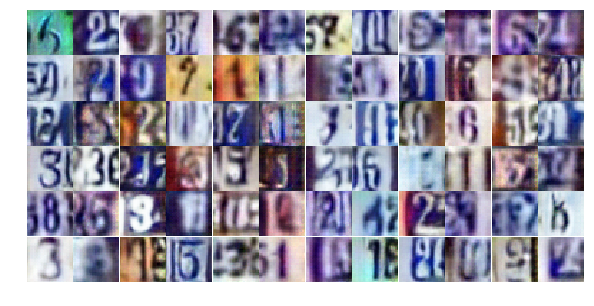

Epoch 13/25... Discriminator Loss: 0.2426... Generator Loss: 1.9137
Epoch 13/25... Discriminator Loss: 1.3473... Generator Loss: 0.4214
Epoch 13/25... Discriminator Loss: 0.5750... Generator Loss: 3.3921
Epoch 13/25... Discriminator Loss: 0.8138... Generator Loss: 1.7754
Epoch 14/25... Discriminator Loss: 1.1307... Generator Loss: 0.5979
Epoch 14/25... Discriminator Loss: 0.7514... Generator Loss: 1.1061
Epoch 14/25... Discriminator Loss: 1.1857... Generator Loss: 0.4861
Epoch 14/25... Discriminator Loss: 0.4368... Generator Loss: 1.9026
Epoch 14/25... Discriminator Loss: 0.4885... Generator Loss: 1.2555
Epoch 14/25... Discriminator Loss: 0.6365... Generator Loss: 1.1030


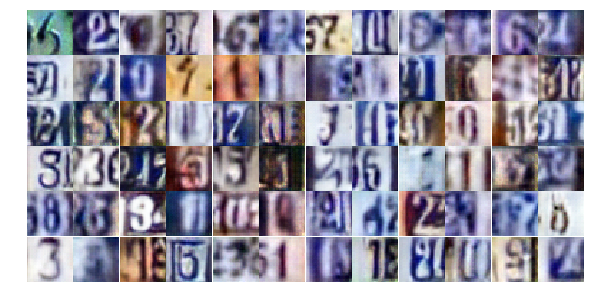

Epoch 14/25... Discriminator Loss: 1.2417... Generator Loss: 4.1731
Epoch 14/25... Discriminator Loss: 0.9013... Generator Loss: 0.7627
Epoch 14/25... Discriminator Loss: 0.6004... Generator Loss: 1.1672
Epoch 14/25... Discriminator Loss: 0.4248... Generator Loss: 1.5224
Epoch 14/25... Discriminator Loss: 1.0999... Generator Loss: 0.5581
Epoch 14/25... Discriminator Loss: 0.3430... Generator Loss: 1.5927
Epoch 14/25... Discriminator Loss: 0.3420... Generator Loss: 1.6097
Epoch 14/25... Discriminator Loss: 1.7297... Generator Loss: 0.2982
Epoch 14/25... Discriminator Loss: 1.3293... Generator Loss: 0.4434
Epoch 14/25... Discriminator Loss: 4.1792... Generator Loss: 0.0254


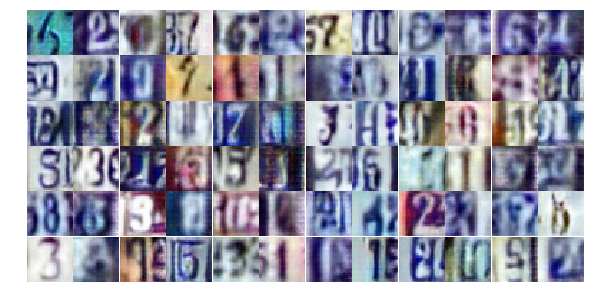

Epoch 14/25... Discriminator Loss: 0.7390... Generator Loss: 1.1077
Epoch 14/25... Discriminator Loss: 0.4877... Generator Loss: 2.7681
Epoch 14/25... Discriminator Loss: 0.6408... Generator Loss: 1.1072
Epoch 14/25... Discriminator Loss: 0.4246... Generator Loss: 1.6696
Epoch 14/25... Discriminator Loss: 0.8199... Generator Loss: 0.9181
Epoch 14/25... Discriminator Loss: 0.6842... Generator Loss: 1.2822
Epoch 14/25... Discriminator Loss: 0.4684... Generator Loss: 1.4273
Epoch 14/25... Discriminator Loss: 0.5824... Generator Loss: 1.1641
Epoch 14/25... Discriminator Loss: 0.5280... Generator Loss: 1.2068
Epoch 14/25... Discriminator Loss: 0.4225... Generator Loss: 1.4111


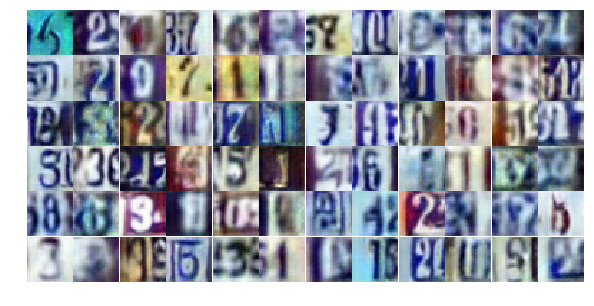

Epoch 14/25... Discriminator Loss: 1.3442... Generator Loss: 0.5024
Epoch 14/25... Discriminator Loss: 0.4930... Generator Loss: 1.8540
Epoch 14/25... Discriminator Loss: 0.6027... Generator Loss: 1.1046
Epoch 14/25... Discriminator Loss: 0.3089... Generator Loss: 1.9840
Epoch 14/25... Discriminator Loss: 0.6941... Generator Loss: 1.1549
Epoch 14/25... Discriminator Loss: 0.5139... Generator Loss: 1.2848
Epoch 14/25... Discriminator Loss: 0.4702... Generator Loss: 1.6095
Epoch 14/25... Discriminator Loss: 0.3942... Generator Loss: 1.4324
Epoch 14/25... Discriminator Loss: 0.4063... Generator Loss: 1.4838
Epoch 14/25... Discriminator Loss: 0.4965... Generator Loss: 1.4251


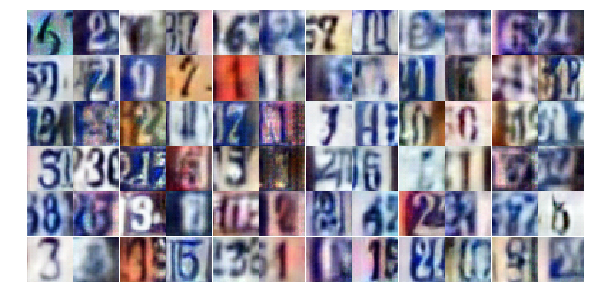

Epoch 14/25... Discriminator Loss: 1.2836... Generator Loss: 0.4805
Epoch 14/25... Discriminator Loss: 0.6795... Generator Loss: 0.9537
Epoch 14/25... Discriminator Loss: 1.4693... Generator Loss: 0.3621
Epoch 14/25... Discriminator Loss: 1.8315... Generator Loss: 0.2767
Epoch 14/25... Discriminator Loss: 0.6195... Generator Loss: 1.0753
Epoch 14/25... Discriminator Loss: 0.5218... Generator Loss: 1.5060
Epoch 14/25... Discriminator Loss: 0.5355... Generator Loss: 1.2894
Epoch 14/25... Discriminator Loss: 0.4958... Generator Loss: 1.1949
Epoch 14/25... Discriminator Loss: 0.8532... Generator Loss: 0.7740
Epoch 14/25... Discriminator Loss: 1.4057... Generator Loss: 0.4886


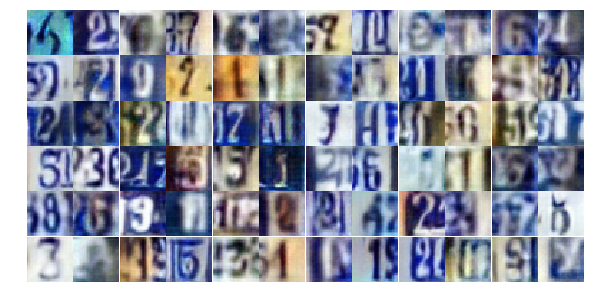

Epoch 14/25... Discriminator Loss: 1.3817... Generator Loss: 0.3994
Epoch 14/25... Discriminator Loss: 1.5795... Generator Loss: 0.3480
Epoch 14/25... Discriminator Loss: 0.5433... Generator Loss: 1.3379
Epoch 14/25... Discriminator Loss: 0.6888... Generator Loss: 0.9620
Epoch 14/25... Discriminator Loss: 0.3999... Generator Loss: 1.5150
Epoch 14/25... Discriminator Loss: 0.6745... Generator Loss: 1.0196
Epoch 14/25... Discriminator Loss: 0.5222... Generator Loss: 1.3572
Epoch 14/25... Discriminator Loss: 0.4541... Generator Loss: 1.4809
Epoch 14/25... Discriminator Loss: 2.6939... Generator Loss: 0.1574
Epoch 14/25... Discriminator Loss: 1.5725... Generator Loss: 0.4697


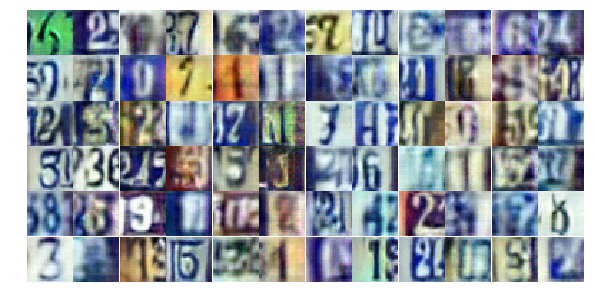

Epoch 14/25... Discriminator Loss: 0.8555... Generator Loss: 1.0771
Epoch 14/25... Discriminator Loss: 1.1915... Generator Loss: 0.5896
Epoch 15/25... Discriminator Loss: 0.9220... Generator Loss: 0.7505
Epoch 15/25... Discriminator Loss: 0.4267... Generator Loss: 1.7193
Epoch 15/25... Discriminator Loss: 0.6238... Generator Loss: 1.1086
Epoch 15/25... Discriminator Loss: 0.8662... Generator Loss: 0.7966
Epoch 15/25... Discriminator Loss: 0.5607... Generator Loss: 1.1487
Epoch 15/25... Discriminator Loss: 0.5520... Generator Loss: 1.1400
Epoch 15/25... Discriminator Loss: 1.5956... Generator Loss: 0.3905
Epoch 15/25... Discriminator Loss: 0.4753... Generator Loss: 1.4500


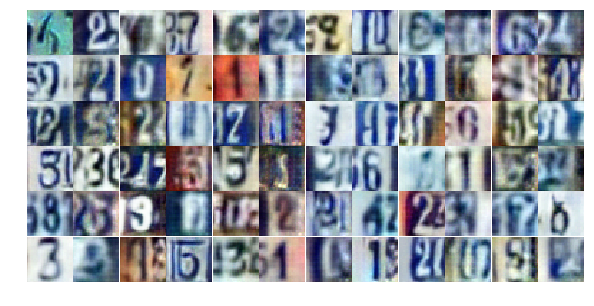

Epoch 15/25... Discriminator Loss: 0.3733... Generator Loss: 1.7081
Epoch 15/25... Discriminator Loss: 0.5235... Generator Loss: 1.3471
Epoch 15/25... Discriminator Loss: 0.4925... Generator Loss: 1.2872
Epoch 15/25... Discriminator Loss: 0.4148... Generator Loss: 1.4741
Epoch 15/25... Discriminator Loss: 0.4107... Generator Loss: 1.6714
Epoch 15/25... Discriminator Loss: 0.2774... Generator Loss: 1.9602
Epoch 15/25... Discriminator Loss: 1.1019... Generator Loss: 0.5731
Epoch 15/25... Discriminator Loss: 0.4879... Generator Loss: 2.5356
Epoch 15/25... Discriminator Loss: 0.3482... Generator Loss: 3.5579
Epoch 15/25... Discriminator Loss: 0.9849... Generator Loss: 0.7675


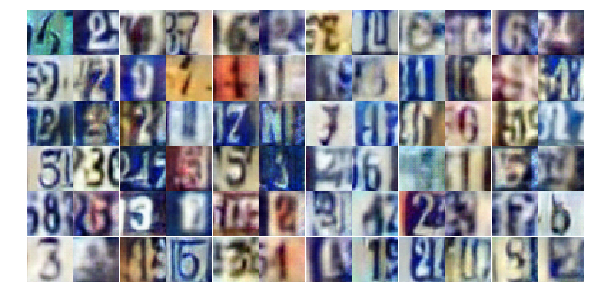

Epoch 15/25... Discriminator Loss: 0.9101... Generator Loss: 0.7415
Epoch 15/25... Discriminator Loss: 0.4070... Generator Loss: 1.9297
Epoch 15/25... Discriminator Loss: 0.3953... Generator Loss: 1.7517
Epoch 15/25... Discriminator Loss: 1.0237... Generator Loss: 0.6474
Epoch 15/25... Discriminator Loss: 0.8069... Generator Loss: 0.9220
Epoch 15/25... Discriminator Loss: 0.6113... Generator Loss: 1.1193
Epoch 15/25... Discriminator Loss: 0.4766... Generator Loss: 1.3920
Epoch 15/25... Discriminator Loss: 1.1906... Generator Loss: 0.5637
Epoch 15/25... Discriminator Loss: 1.2531... Generator Loss: 3.1607
Epoch 15/25... Discriminator Loss: 1.0620... Generator Loss: 0.7800


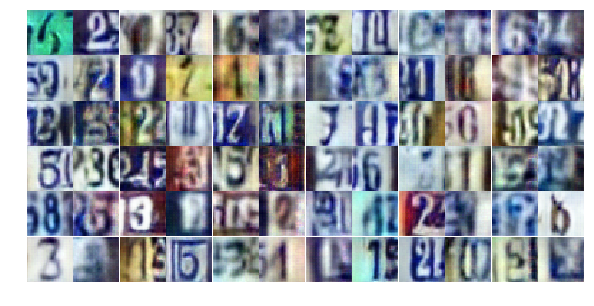

Epoch 15/25... Discriminator Loss: 0.7341... Generator Loss: 1.0939
Epoch 15/25... Discriminator Loss: 0.7132... Generator Loss: 1.0145
Epoch 15/25... Discriminator Loss: 0.6838... Generator Loss: 0.9724
Epoch 15/25... Discriminator Loss: 0.6019... Generator Loss: 1.1522
Epoch 15/25... Discriminator Loss: 0.4511... Generator Loss: 1.4426
Epoch 15/25... Discriminator Loss: 0.7620... Generator Loss: 1.8880
Epoch 15/25... Discriminator Loss: 0.3998... Generator Loss: 1.7898
Epoch 15/25... Discriminator Loss: 0.6714... Generator Loss: 0.9626
Epoch 15/25... Discriminator Loss: 0.4364... Generator Loss: 1.5186
Epoch 15/25... Discriminator Loss: 0.8732... Generator Loss: 0.8122


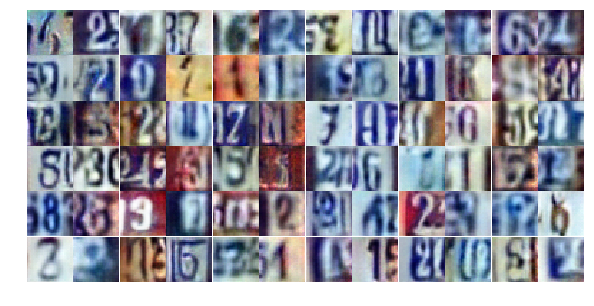

Epoch 15/25... Discriminator Loss: 0.3999... Generator Loss: 1.5450
Epoch 15/25... Discriminator Loss: 0.7610... Generator Loss: 0.9944
Epoch 15/25... Discriminator Loss: 0.6222... Generator Loss: 1.1191
Epoch 15/25... Discriminator Loss: 0.3523... Generator Loss: 1.7175
Epoch 15/25... Discriminator Loss: 0.4447... Generator Loss: 1.4433
Epoch 15/25... Discriminator Loss: 2.2774... Generator Loss: 0.1917
Epoch 15/25... Discriminator Loss: 0.8537... Generator Loss: 1.1015
Epoch 15/25... Discriminator Loss: 0.8701... Generator Loss: 0.9479
Epoch 15/25... Discriminator Loss: 0.5541... Generator Loss: 1.4001
Epoch 15/25... Discriminator Loss: 0.6739... Generator Loss: 0.9587


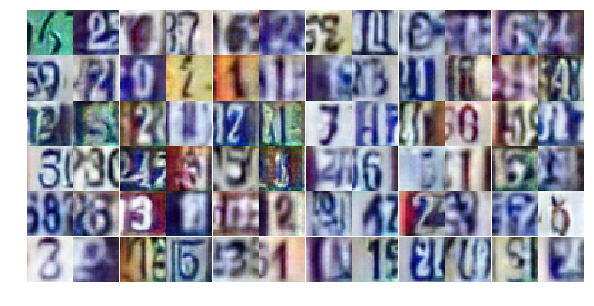

Epoch 15/25... Discriminator Loss: 1.0816... Generator Loss: 0.5994
Epoch 15/25... Discriminator Loss: 0.6299... Generator Loss: 1.0595
Epoch 15/25... Discriminator Loss: 0.3301... Generator Loss: 1.7816
Epoch 15/25... Discriminator Loss: 0.6500... Generator Loss: 1.1806
Epoch 15/25... Discriminator Loss: 0.4593... Generator Loss: 1.5553
Epoch 15/25... Discriminator Loss: 0.6985... Generator Loss: 0.9583
Epoch 15/25... Discriminator Loss: 0.5405... Generator Loss: 1.2615
Epoch 15/25... Discriminator Loss: 1.0062... Generator Loss: 0.7080
Epoch 15/25... Discriminator Loss: 1.3076... Generator Loss: 0.5228
Epoch 16/25... Discriminator Loss: 1.1715... Generator Loss: 0.6178


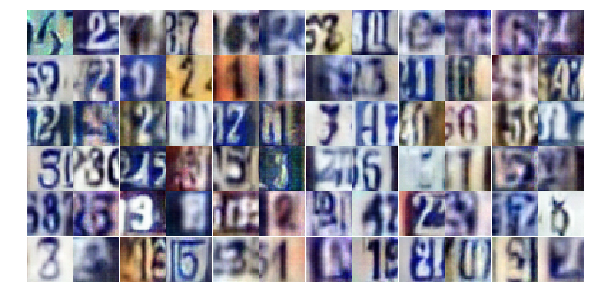

Epoch 16/25... Discriminator Loss: 0.4010... Generator Loss: 1.6125
Epoch 16/25... Discriminator Loss: 0.5605... Generator Loss: 1.2095
Epoch 16/25... Discriminator Loss: 1.1319... Generator Loss: 0.6522
Epoch 16/25... Discriminator Loss: 0.4630... Generator Loss: 1.4965
Epoch 16/25... Discriminator Loss: 0.4692... Generator Loss: 2.2630
Epoch 16/25... Discriminator Loss: 0.4252... Generator Loss: 2.1386
Epoch 16/25... Discriminator Loss: 1.7844... Generator Loss: 0.2774
Epoch 16/25... Discriminator Loss: 0.6360... Generator Loss: 2.8280
Epoch 16/25... Discriminator Loss: 0.5555... Generator Loss: 1.3658
Epoch 16/25... Discriminator Loss: 0.4063... Generator Loss: 1.8452


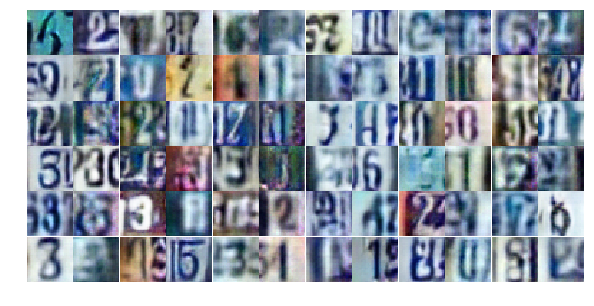

Epoch 16/25... Discriminator Loss: 1.5816... Generator Loss: 0.3821
Epoch 16/25... Discriminator Loss: 0.4127... Generator Loss: 1.5176
Epoch 16/25... Discriminator Loss: 0.3845... Generator Loss: 2.1025
Epoch 16/25... Discriminator Loss: 0.6934... Generator Loss: 1.0753
Epoch 16/25... Discriminator Loss: 0.3031... Generator Loss: 1.7507
Epoch 16/25... Discriminator Loss: 0.5076... Generator Loss: 1.2053
Epoch 16/25... Discriminator Loss: 2.2776... Generator Loss: 0.2055
Epoch 16/25... Discriminator Loss: 0.5949... Generator Loss: 1.3393
Epoch 16/25... Discriminator Loss: 0.5190... Generator Loss: 1.5506
Epoch 16/25... Discriminator Loss: 0.7562... Generator Loss: 0.9174


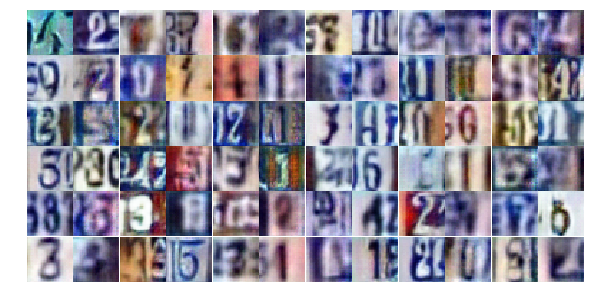

Epoch 16/25... Discriminator Loss: 0.4930... Generator Loss: 1.3663
Epoch 16/25... Discriminator Loss: 0.7570... Generator Loss: 1.0021
Epoch 16/25... Discriminator Loss: 0.7378... Generator Loss: 0.8892
Epoch 16/25... Discriminator Loss: 1.0764... Generator Loss: 0.6133
Epoch 16/25... Discriminator Loss: 1.5227... Generator Loss: 0.4736
Epoch 16/25... Discriminator Loss: 0.6849... Generator Loss: 1.2966
Epoch 16/25... Discriminator Loss: 0.7824... Generator Loss: 0.8669
Epoch 16/25... Discriminator Loss: 0.4152... Generator Loss: 1.6607
Epoch 16/25... Discriminator Loss: 1.3937... Generator Loss: 0.4641
Epoch 16/25... Discriminator Loss: 0.4530... Generator Loss: 1.7192


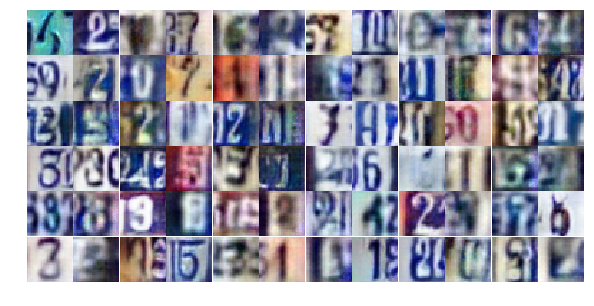

Epoch 16/25... Discriminator Loss: 0.5159... Generator Loss: 1.2729
Epoch 16/25... Discriminator Loss: 0.4678... Generator Loss: 1.4859
Epoch 16/25... Discriminator Loss: 0.6083... Generator Loss: 1.0498
Epoch 16/25... Discriminator Loss: 0.4384... Generator Loss: 1.6576
Epoch 16/25... Discriminator Loss: 1.0218... Generator Loss: 0.6797
Epoch 16/25... Discriminator Loss: 0.5534... Generator Loss: 1.2038
Epoch 16/25... Discriminator Loss: 0.6669... Generator Loss: 1.2080
Epoch 16/25... Discriminator Loss: 0.7731... Generator Loss: 0.8886
Epoch 16/25... Discriminator Loss: 0.8921... Generator Loss: 0.7853
Epoch 16/25... Discriminator Loss: 0.3863... Generator Loss: 1.4986


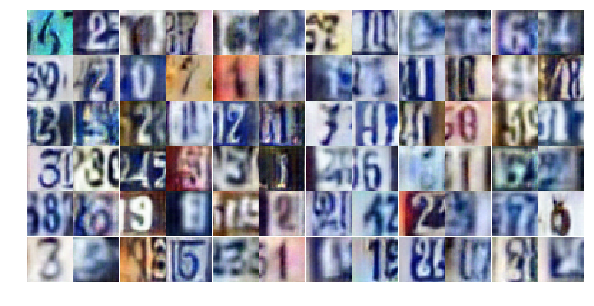

Epoch 16/25... Discriminator Loss: 0.4235... Generator Loss: 1.5318
Epoch 16/25... Discriminator Loss: 0.7947... Generator Loss: 0.9294
Epoch 16/25... Discriminator Loss: 0.7612... Generator Loss: 0.8796
Epoch 16/25... Discriminator Loss: 0.3402... Generator Loss: 2.7477
Epoch 16/25... Discriminator Loss: 1.8647... Generator Loss: 0.3423
Epoch 16/25... Discriminator Loss: 1.4214... Generator Loss: 0.5610
Epoch 16/25... Discriminator Loss: 0.5057... Generator Loss: 4.0607
Epoch 16/25... Discriminator Loss: 1.6641... Generator Loss: 0.3750
Epoch 16/25... Discriminator Loss: 0.3184... Generator Loss: 2.3590
Epoch 16/25... Discriminator Loss: 0.5356... Generator Loss: 1.3306


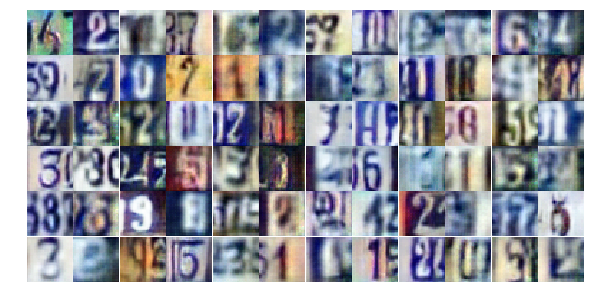

Epoch 16/25... Discriminator Loss: 0.9456... Generator Loss: 0.7642
Epoch 16/25... Discriminator Loss: 0.5401... Generator Loss: 1.3542
Epoch 16/25... Discriminator Loss: 1.0105... Generator Loss: 0.7481
Epoch 16/25... Discriminator Loss: 0.2197... Generator Loss: 2.7464
Epoch 16/25... Discriminator Loss: 0.4104... Generator Loss: 1.8969
Epoch 16/25... Discriminator Loss: 1.5087... Generator Loss: 0.3787
Epoch 17/25... Discriminator Loss: 0.6744... Generator Loss: 1.0770
Epoch 17/25... Discriminator Loss: 0.6366... Generator Loss: 1.0321
Epoch 17/25... Discriminator Loss: 0.5316... Generator Loss: 1.2710
Epoch 17/25... Discriminator Loss: 0.4570... Generator Loss: 1.5788


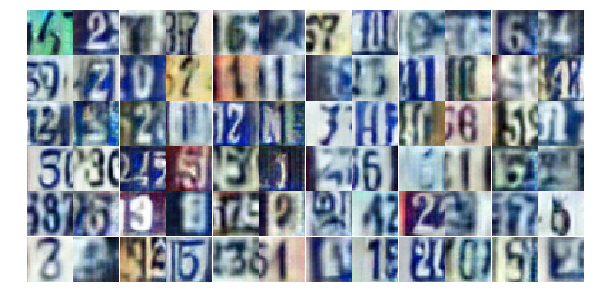

Epoch 17/25... Discriminator Loss: 0.5609... Generator Loss: 1.2305
Epoch 17/25... Discriminator Loss: 0.5913... Generator Loss: 1.1171
Epoch 17/25... Discriminator Loss: 0.7110... Generator Loss: 1.0325
Epoch 17/25... Discriminator Loss: 0.5367... Generator Loss: 1.2741
Epoch 17/25... Discriminator Loss: 0.9491... Generator Loss: 0.7035
Epoch 17/25... Discriminator Loss: 0.8793... Generator Loss: 0.8247
Epoch 17/25... Discriminator Loss: 0.3992... Generator Loss: 1.6232
Epoch 17/25... Discriminator Loss: 0.5086... Generator Loss: 1.2106
Epoch 17/25... Discriminator Loss: 0.3209... Generator Loss: 1.9315
Epoch 17/25... Discriminator Loss: 0.5514... Generator Loss: 1.3396


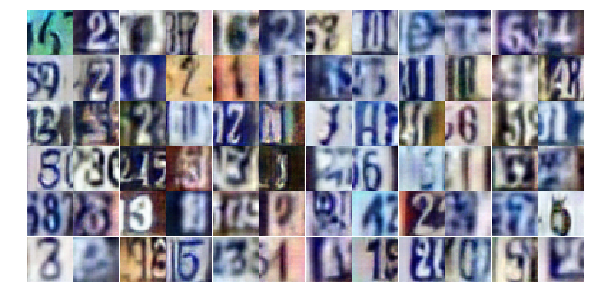

Epoch 17/25... Discriminator Loss: 0.7087... Generator Loss: 0.9517
Epoch 17/25... Discriminator Loss: 0.4754... Generator Loss: 1.2876
Epoch 17/25... Discriminator Loss: 0.3003... Generator Loss: 1.9031
Epoch 17/25... Discriminator Loss: 3.6098... Generator Loss: 0.0888
Epoch 17/25... Discriminator Loss: 2.3988... Generator Loss: 2.5305
Epoch 17/25... Discriminator Loss: 1.4969... Generator Loss: 0.9876
Epoch 17/25... Discriminator Loss: 1.0942... Generator Loss: 2.1693
Epoch 17/25... Discriminator Loss: 0.7766... Generator Loss: 2.1816
Epoch 17/25... Discriminator Loss: 0.7985... Generator Loss: 1.5039
Epoch 17/25... Discriminator Loss: 0.6966... Generator Loss: 1.2664


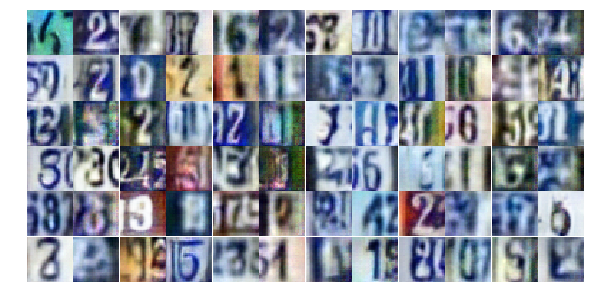

Epoch 17/25... Discriminator Loss: 1.6326... Generator Loss: 0.3789
Epoch 17/25... Discriminator Loss: 0.4504... Generator Loss: 1.7284
Epoch 17/25... Discriminator Loss: 0.4023... Generator Loss: 1.8765
Epoch 17/25... Discriminator Loss: 1.4501... Generator Loss: 0.3922
Epoch 17/25... Discriminator Loss: 1.3671... Generator Loss: 0.4528
Epoch 17/25... Discriminator Loss: 0.3838... Generator Loss: 1.5334
Epoch 17/25... Discriminator Loss: 0.4541... Generator Loss: 1.4767
Epoch 17/25... Discriminator Loss: 0.6763... Generator Loss: 1.0361
Epoch 17/25... Discriminator Loss: 0.8124... Generator Loss: 0.8425
Epoch 17/25... Discriminator Loss: 0.3214... Generator Loss: 2.1891


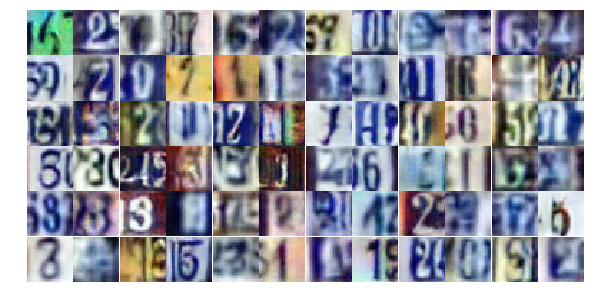

Epoch 17/25... Discriminator Loss: 0.5556... Generator Loss: 2.2001
Epoch 17/25... Discriminator Loss: 0.6933... Generator Loss: 1.2311
Epoch 17/25... Discriminator Loss: 0.5463... Generator Loss: 2.0005
Epoch 17/25... Discriminator Loss: 0.6752... Generator Loss: 1.0230
Epoch 17/25... Discriminator Loss: 0.5913... Generator Loss: 1.1901
Epoch 17/25... Discriminator Loss: 0.7581... Generator Loss: 0.8551
Epoch 17/25... Discriminator Loss: 0.6763... Generator Loss: 1.1001
Epoch 17/25... Discriminator Loss: 0.3649... Generator Loss: 1.6987
Epoch 17/25... Discriminator Loss: 0.3574... Generator Loss: 1.6369
Epoch 17/25... Discriminator Loss: 0.9126... Generator Loss: 0.6907


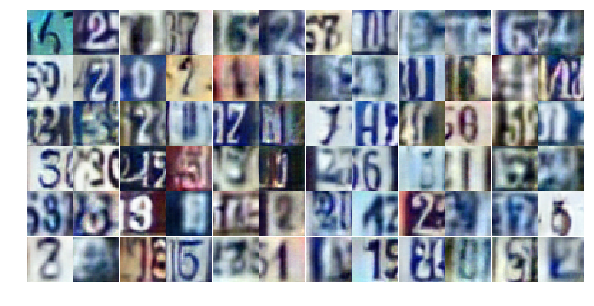

Epoch 17/25... Discriminator Loss: 1.5424... Generator Loss: 0.4438
Epoch 17/25... Discriminator Loss: 0.3293... Generator Loss: 1.9038
Epoch 17/25... Discriminator Loss: 0.4971... Generator Loss: 2.3192
Epoch 17/25... Discriminator Loss: 0.2946... Generator Loss: 1.8022
Epoch 17/25... Discriminator Loss: 0.5765... Generator Loss: 1.1680
Epoch 17/25... Discriminator Loss: 0.9090... Generator Loss: 0.7206
Epoch 17/25... Discriminator Loss: 0.7721... Generator Loss: 0.8723
Epoch 17/25... Discriminator Loss: 0.4159... Generator Loss: 1.7637
Epoch 17/25... Discriminator Loss: 0.7832... Generator Loss: 2.6127
Epoch 17/25... Discriminator Loss: 1.0635... Generator Loss: 0.6305


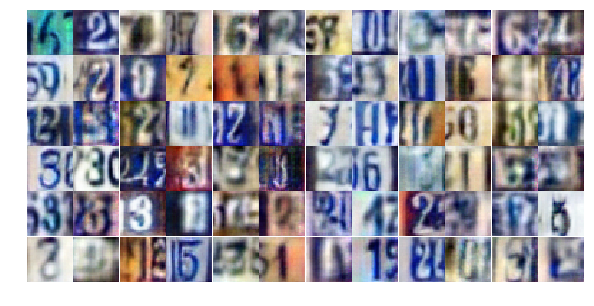

Epoch 17/25... Discriminator Loss: 0.4235... Generator Loss: 1.8213
Epoch 17/25... Discriminator Loss: 1.2954... Generator Loss: 0.4880
Epoch 17/25... Discriminator Loss: 0.2890... Generator Loss: 1.9923
Epoch 17/25... Discriminator Loss: 0.8511... Generator Loss: 0.7837
Epoch 18/25... Discriminator Loss: 1.0504... Generator Loss: 0.6750
Epoch 18/25... Discriminator Loss: 0.6917... Generator Loss: 0.9448
Epoch 18/25... Discriminator Loss: 0.9113... Generator Loss: 0.7279
Epoch 18/25... Discriminator Loss: 0.7000... Generator Loss: 1.0345
Epoch 18/25... Discriminator Loss: 1.2385... Generator Loss: 0.4940
Epoch 18/25... Discriminator Loss: 0.6238... Generator Loss: 1.0329


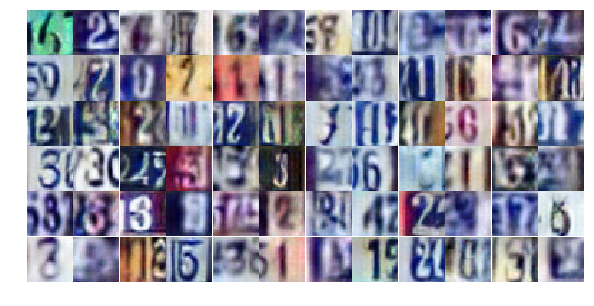

Epoch 18/25... Discriminator Loss: 0.3633... Generator Loss: 1.9761
Epoch 18/25... Discriminator Loss: 0.7682... Generator Loss: 0.8545
Epoch 18/25... Discriminator Loss: 0.5605... Generator Loss: 2.4635
Epoch 18/25... Discriminator Loss: 0.3764... Generator Loss: 2.1059
Epoch 18/25... Discriminator Loss: 0.4846... Generator Loss: 1.3720
Epoch 18/25... Discriminator Loss: 1.1514... Generator Loss: 0.5663
Epoch 18/25... Discriminator Loss: 0.4357... Generator Loss: 1.4527
Epoch 18/25... Discriminator Loss: 0.5643... Generator Loss: 1.1350
Epoch 18/25... Discriminator Loss: 0.4799... Generator Loss: 1.2762
Epoch 18/25... Discriminator Loss: 0.2405... Generator Loss: 2.1627


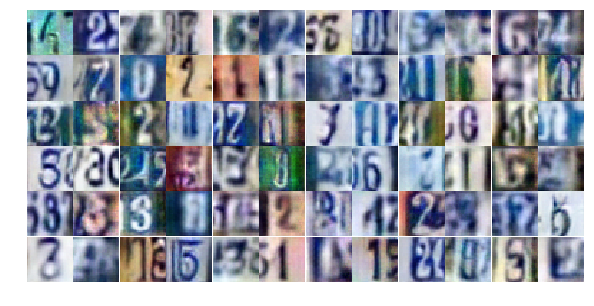

Epoch 18/25... Discriminator Loss: 0.2463... Generator Loss: 2.0673
Epoch 18/25... Discriminator Loss: 3.3160... Generator Loss: 0.7074
Epoch 18/25... Discriminator Loss: 1.7277... Generator Loss: 0.9688
Epoch 18/25... Discriminator Loss: 1.6341... Generator Loss: 0.8202
Epoch 18/25... Discriminator Loss: 1.3153... Generator Loss: 1.0531
Epoch 18/25... Discriminator Loss: 1.6319... Generator Loss: 0.7971
Epoch 18/25... Discriminator Loss: 1.5809... Generator Loss: 0.7220
Epoch 18/25... Discriminator Loss: 1.1936... Generator Loss: 1.1766
Epoch 18/25... Discriminator Loss: 0.9746... Generator Loss: 1.3635
Epoch 18/25... Discriminator Loss: 0.8068... Generator Loss: 1.7697


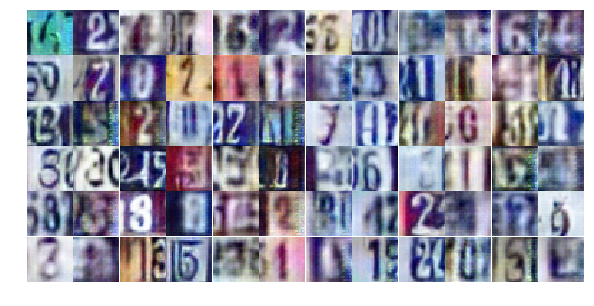

Epoch 18/25... Discriminator Loss: 0.6259... Generator Loss: 1.2378
Epoch 18/25... Discriminator Loss: 0.5866... Generator Loss: 2.2228
Epoch 18/25... Discriminator Loss: 0.5719... Generator Loss: 1.3185
Epoch 18/25... Discriminator Loss: 1.0357... Generator Loss: 0.7638
Epoch 18/25... Discriminator Loss: 0.8556... Generator Loss: 0.8353
Epoch 18/25... Discriminator Loss: 0.5462... Generator Loss: 1.3041
Epoch 18/25... Discriminator Loss: 0.5884... Generator Loss: 1.2013
Epoch 18/25... Discriminator Loss: 0.3483... Generator Loss: 2.1479
Epoch 18/25... Discriminator Loss: 0.6243... Generator Loss: 1.0979
Epoch 18/25... Discriminator Loss: 0.8589... Generator Loss: 0.9073


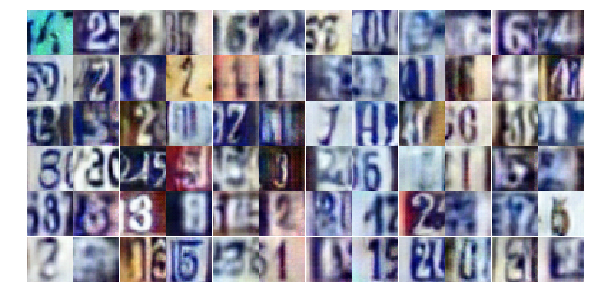

Epoch 18/25... Discriminator Loss: 0.5612... Generator Loss: 1.6587
Epoch 18/25... Discriminator Loss: 0.5969... Generator Loss: 1.2592
Epoch 18/25... Discriminator Loss: 0.7415... Generator Loss: 0.9609
Epoch 18/25... Discriminator Loss: 0.7356... Generator Loss: 0.8334
Epoch 18/25... Discriminator Loss: 0.7564... Generator Loss: 0.9688
Epoch 18/25... Discriminator Loss: 0.4049... Generator Loss: 1.4425
Epoch 18/25... Discriminator Loss: 0.7639... Generator Loss: 0.8707
Epoch 18/25... Discriminator Loss: 3.4091... Generator Loss: 5.3382
Epoch 18/25... Discriminator Loss: 1.0889... Generator Loss: 0.6466
Epoch 18/25... Discriminator Loss: 0.2848... Generator Loss: 2.0024


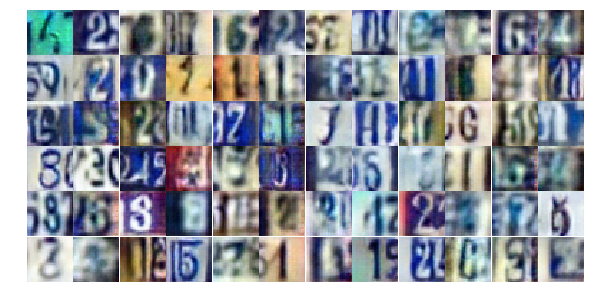

Epoch 18/25... Discriminator Loss: 0.4605... Generator Loss: 1.3923
Epoch 18/25... Discriminator Loss: 0.5809... Generator Loss: 1.1809
Epoch 18/25... Discriminator Loss: 0.6931... Generator Loss: 0.9853
Epoch 18/25... Discriminator Loss: 0.8464... Generator Loss: 0.8051
Epoch 18/25... Discriminator Loss: 0.5229... Generator Loss: 1.3453
Epoch 18/25... Discriminator Loss: 0.4507... Generator Loss: 2.3018
Epoch 18/25... Discriminator Loss: 0.4753... Generator Loss: 1.3620
Epoch 18/25... Discriminator Loss: 0.3787... Generator Loss: 1.6467
Epoch 18/25... Discriminator Loss: 0.8189... Generator Loss: 0.8342
Epoch 18/25... Discriminator Loss: 0.3604... Generator Loss: 1.5904


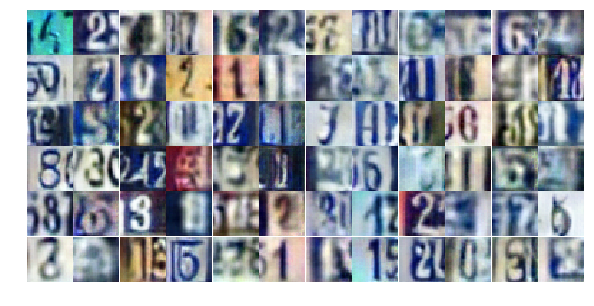

Epoch 18/25... Discriminator Loss: 0.6758... Generator Loss: 3.3581
Epoch 19/25... Discriminator Loss: 0.5435... Generator Loss: 1.7497
Epoch 19/25... Discriminator Loss: 1.0901... Generator Loss: 0.6395
Epoch 19/25... Discriminator Loss: 2.3806... Generator Loss: 0.1771
Epoch 19/25... Discriminator Loss: 0.6199... Generator Loss: 3.3082
Epoch 19/25... Discriminator Loss: 1.0146... Generator Loss: 0.8315
Epoch 19/25... Discriminator Loss: 0.3348... Generator Loss: 1.9320
Epoch 19/25... Discriminator Loss: 0.8850... Generator Loss: 0.9304
Epoch 19/25... Discriminator Loss: 0.5228... Generator Loss: 1.9180
Epoch 19/25... Discriminator Loss: 0.6775... Generator Loss: 1.0072


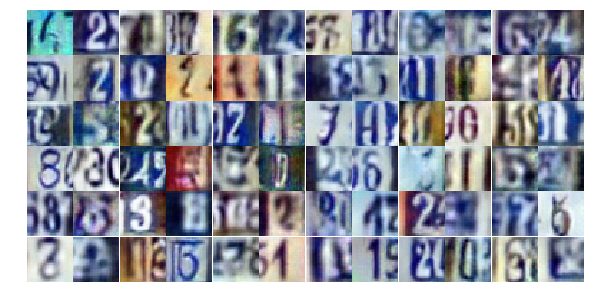

Epoch 19/25... Discriminator Loss: 0.5264... Generator Loss: 1.2056
Epoch 19/25... Discriminator Loss: 0.4580... Generator Loss: 1.5443
Epoch 19/25... Discriminator Loss: 0.7215... Generator Loss: 0.9433
Epoch 19/25... Discriminator Loss: 1.0011... Generator Loss: 0.6615
Epoch 19/25... Discriminator Loss: 0.6334... Generator Loss: 1.1049
Epoch 19/25... Discriminator Loss: 0.7486... Generator Loss: 0.9777
Epoch 19/25... Discriminator Loss: 0.6038... Generator Loss: 1.0325
Epoch 19/25... Discriminator Loss: 0.3865... Generator Loss: 1.6850
Epoch 19/25... Discriminator Loss: 1.3383... Generator Loss: 3.8241
Epoch 19/25... Discriminator Loss: 1.0420... Generator Loss: 0.9428


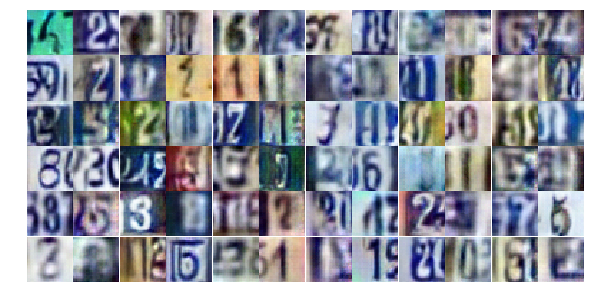

Epoch 19/25... Discriminator Loss: 0.5499... Generator Loss: 1.5021
Epoch 19/25... Discriminator Loss: 0.7390... Generator Loss: 1.0789
Epoch 19/25... Discriminator Loss: 1.2164... Generator Loss: 0.6004
Epoch 19/25... Discriminator Loss: 0.7277... Generator Loss: 0.9078
Epoch 19/25... Discriminator Loss: 0.8643... Generator Loss: 0.8624
Epoch 19/25... Discriminator Loss: 0.6285... Generator Loss: 1.0760
Epoch 19/25... Discriminator Loss: 0.7264... Generator Loss: 0.9749
Epoch 19/25... Discriminator Loss: 0.5427... Generator Loss: 1.2995
Epoch 19/25... Discriminator Loss: 0.6315... Generator Loss: 0.9928
Epoch 19/25... Discriminator Loss: 0.8356... Generator Loss: 0.7990


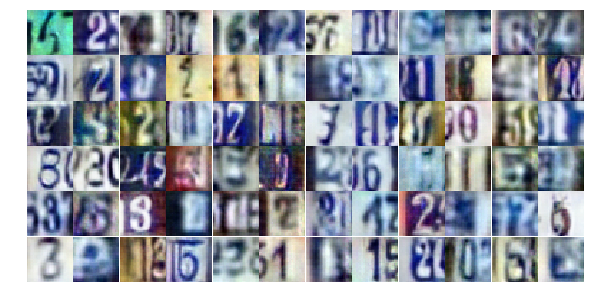

Epoch 19/25... Discriminator Loss: 0.9103... Generator Loss: 0.8067
Epoch 19/25... Discriminator Loss: 0.3633... Generator Loss: 1.6080
Epoch 19/25... Discriminator Loss: 0.7661... Generator Loss: 0.9000
Epoch 19/25... Discriminator Loss: 0.3887... Generator Loss: 1.5232
Epoch 19/25... Discriminator Loss: 0.4779... Generator Loss: 1.3423
Epoch 19/25... Discriminator Loss: 2.5631... Generator Loss: 0.1825
Epoch 19/25... Discriminator Loss: 1.5186... Generator Loss: 0.5452
Epoch 19/25... Discriminator Loss: 0.5197... Generator Loss: 1.5125
Epoch 19/25... Discriminator Loss: 0.5487... Generator Loss: 1.3066
Epoch 19/25... Discriminator Loss: 0.3491... Generator Loss: 1.9930


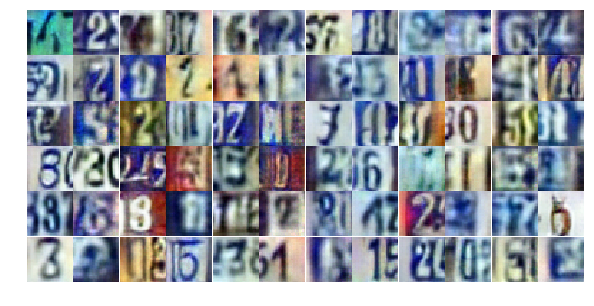

Epoch 19/25... Discriminator Loss: 0.5123... Generator Loss: 1.2634
Epoch 19/25... Discriminator Loss: 0.9687... Generator Loss: 0.7364
Epoch 19/25... Discriminator Loss: 1.0740... Generator Loss: 0.6607
Epoch 19/25... Discriminator Loss: 0.4668... Generator Loss: 1.4925
Epoch 19/25... Discriminator Loss: 0.6929... Generator Loss: 1.0207
Epoch 19/25... Discriminator Loss: 0.5271... Generator Loss: 1.3520
Epoch 19/25... Discriminator Loss: 0.5408... Generator Loss: 1.2187
Epoch 19/25... Discriminator Loss: 0.3416... Generator Loss: 1.5970
Epoch 19/25... Discriminator Loss: 0.5176... Generator Loss: 1.3634
Epoch 19/25... Discriminator Loss: 0.8631... Generator Loss: 0.7850


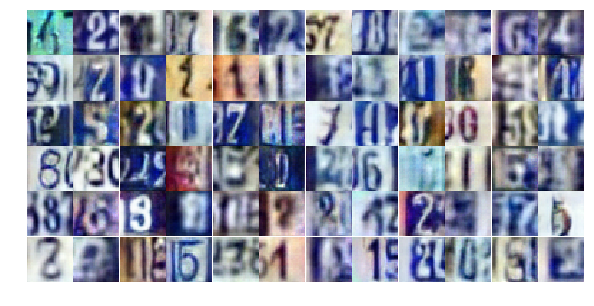

Epoch 19/25... Discriminator Loss: 0.5940... Generator Loss: 1.1099
Epoch 19/25... Discriminator Loss: 0.7523... Generator Loss: 0.9814
Epoch 19/25... Discriminator Loss: 0.5557... Generator Loss: 2.6644
Epoch 19/25... Discriminator Loss: 0.5382... Generator Loss: 1.2434
Epoch 19/25... Discriminator Loss: 0.5532... Generator Loss: 1.3093
Epoch 19/25... Discriminator Loss: 0.4305... Generator Loss: 2.0099
Epoch 19/25... Discriminator Loss: 2.0893... Generator Loss: 0.2353
Epoch 19/25... Discriminator Loss: 0.5386... Generator Loss: 1.2410
Epoch 20/25... Discriminator Loss: 0.9010... Generator Loss: 0.6875
Epoch 20/25... Discriminator Loss: 0.8528... Generator Loss: 0.8056


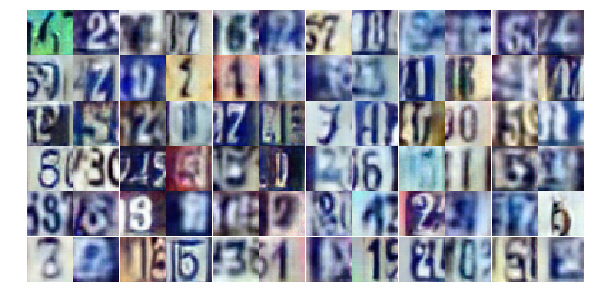

Epoch 20/25... Discriminator Loss: 0.2726... Generator Loss: 2.1113
Epoch 20/25... Discriminator Loss: 0.8288... Generator Loss: 0.9124
Epoch 20/25... Discriminator Loss: 1.9208... Generator Loss: 0.2748
Epoch 20/25... Discriminator Loss: 2.3570... Generator Loss: 0.2690
Epoch 20/25... Discriminator Loss: 0.7622... Generator Loss: 0.9673
Epoch 20/25... Discriminator Loss: 0.9846... Generator Loss: 0.6697
Epoch 20/25... Discriminator Loss: 0.6461... Generator Loss: 1.1465
Epoch 20/25... Discriminator Loss: 1.0503... Generator Loss: 0.6587
Epoch 20/25... Discriminator Loss: 0.5148... Generator Loss: 1.9345
Epoch 20/25... Discriminator Loss: 0.4930... Generator Loss: 1.2103


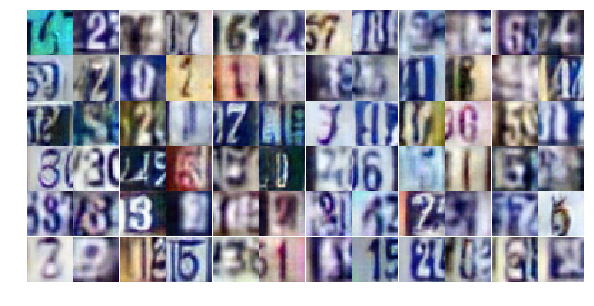

Epoch 20/25... Discriminator Loss: 0.8824... Generator Loss: 0.8018
Epoch 20/25... Discriminator Loss: 1.0614... Generator Loss: 0.6829
Epoch 20/25... Discriminator Loss: 0.4642... Generator Loss: 1.5675
Epoch 20/25... Discriminator Loss: 0.6297... Generator Loss: 1.0868
Epoch 20/25... Discriminator Loss: 1.1365... Generator Loss: 0.5456
Epoch 20/25... Discriminator Loss: 1.6584... Generator Loss: 1.3672
Epoch 20/25... Discriminator Loss: 2.1061... Generator Loss: 2.4686
Epoch 20/25... Discriminator Loss: 1.1809... Generator Loss: 3.5598
Epoch 20/25... Discriminator Loss: 0.7614... Generator Loss: 1.1149
Epoch 20/25... Discriminator Loss: 1.5112... Generator Loss: 0.4855


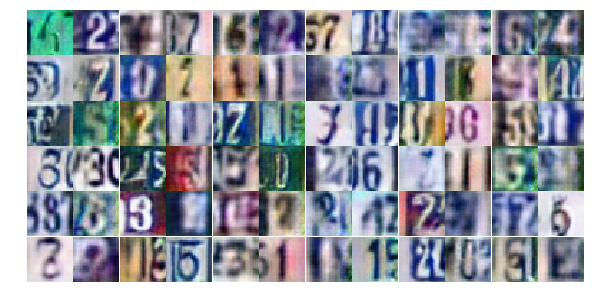

Epoch 20/25... Discriminator Loss: 0.5747... Generator Loss: 1.3341
Epoch 20/25... Discriminator Loss: 0.8977... Generator Loss: 0.8658
Epoch 20/25... Discriminator Loss: 0.3057... Generator Loss: 3.2825
Epoch 20/25... Discriminator Loss: 1.0619... Generator Loss: 0.6871
Epoch 20/25... Discriminator Loss: 0.6085... Generator Loss: 1.2166
Epoch 20/25... Discriminator Loss: 0.4885... Generator Loss: 1.4468
Epoch 20/25... Discriminator Loss: 0.5537... Generator Loss: 2.3657
Epoch 20/25... Discriminator Loss: 1.1076... Generator Loss: 0.5812
Epoch 20/25... Discriminator Loss: 0.9385... Generator Loss: 0.7076
Epoch 20/25... Discriminator Loss: 0.7830... Generator Loss: 0.9194


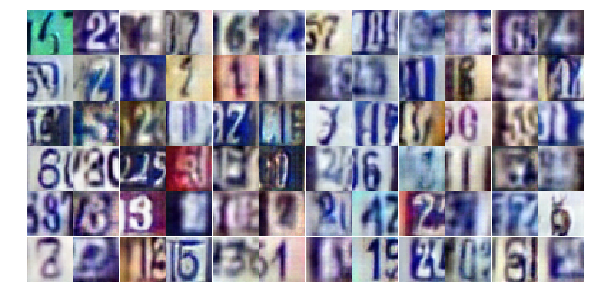

Epoch 20/25... Discriminator Loss: 0.5195... Generator Loss: 1.2829
Epoch 20/25... Discriminator Loss: 0.4098... Generator Loss: 1.5311
Epoch 20/25... Discriminator Loss: 0.7331... Generator Loss: 0.9798
Epoch 20/25... Discriminator Loss: 0.5165... Generator Loss: 1.2937
Epoch 20/25... Discriminator Loss: 0.5201... Generator Loss: 1.5219
Epoch 20/25... Discriminator Loss: 0.5432... Generator Loss: 1.5238
Epoch 20/25... Discriminator Loss: 0.5393... Generator Loss: 1.4533
Epoch 20/25... Discriminator Loss: 0.5502... Generator Loss: 1.9342
Epoch 20/25... Discriminator Loss: 0.9395... Generator Loss: 0.7434
Epoch 20/25... Discriminator Loss: 1.0770... Generator Loss: 0.6904


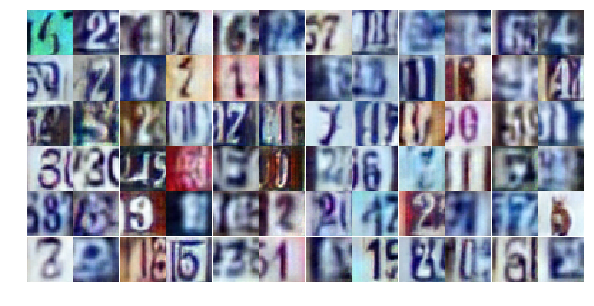

Epoch 20/25... Discriminator Loss: 0.5275... Generator Loss: 1.2651
Epoch 20/25... Discriminator Loss: 0.5333... Generator Loss: 1.2250
Epoch 20/25... Discriminator Loss: 0.5974... Generator Loss: 1.1523
Epoch 20/25... Discriminator Loss: 0.7483... Generator Loss: 0.9011
Epoch 20/25... Discriminator Loss: 0.3714... Generator Loss: 1.9263
Epoch 20/25... Discriminator Loss: 0.6397... Generator Loss: 1.2975
Epoch 20/25... Discriminator Loss: 0.7617... Generator Loss: 0.9620
Epoch 20/25... Discriminator Loss: 0.5490... Generator Loss: 1.1889
Epoch 20/25... Discriminator Loss: 0.4588... Generator Loss: 1.3599
Epoch 20/25... Discriminator Loss: 0.3513... Generator Loss: 1.7422


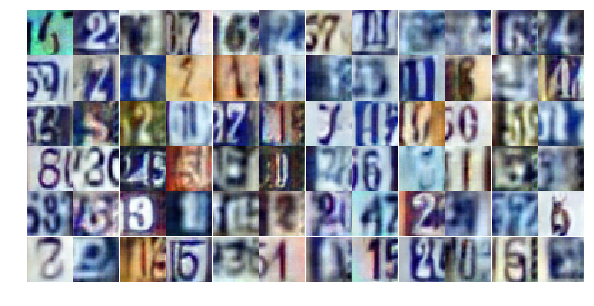

Epoch 20/25... Discriminator Loss: 0.3432... Generator Loss: 1.9312
Epoch 20/25... Discriminator Loss: 0.7494... Generator Loss: 3.6148
Epoch 20/25... Discriminator Loss: 0.3727... Generator Loss: 1.6602
Epoch 20/25... Discriminator Loss: 1.3855... Generator Loss: 2.4528
Epoch 20/25... Discriminator Loss: 0.7081... Generator Loss: 0.9880
Epoch 20/25... Discriminator Loss: 0.7484... Generator Loss: 0.9177
Epoch 21/25... Discriminator Loss: 0.9037... Generator Loss: 0.8597
Epoch 21/25... Discriminator Loss: 0.7108... Generator Loss: 0.9578
Epoch 21/25... Discriminator Loss: 1.6026... Generator Loss: 0.3218
Epoch 21/25... Discriminator Loss: 0.8085... Generator Loss: 0.8548


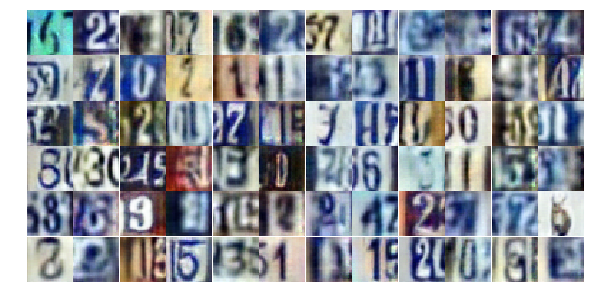

Epoch 21/25... Discriminator Loss: 0.4922... Generator Loss: 1.4974
Epoch 21/25... Discriminator Loss: 1.6754... Generator Loss: 0.4595
Epoch 21/25... Discriminator Loss: 1.1048... Generator Loss: 0.6976
Epoch 21/25... Discriminator Loss: 0.5092... Generator Loss: 1.1675
Epoch 21/25... Discriminator Loss: 0.4796... Generator Loss: 2.0120
Epoch 21/25... Discriminator Loss: 0.4973... Generator Loss: 1.3811
Epoch 21/25... Discriminator Loss: 0.7953... Generator Loss: 0.9651
Epoch 21/25... Discriminator Loss: 0.6110... Generator Loss: 1.2976
Epoch 21/25... Discriminator Loss: 0.8177... Generator Loss: 0.8931
Epoch 21/25... Discriminator Loss: 1.1202... Generator Loss: 0.6032


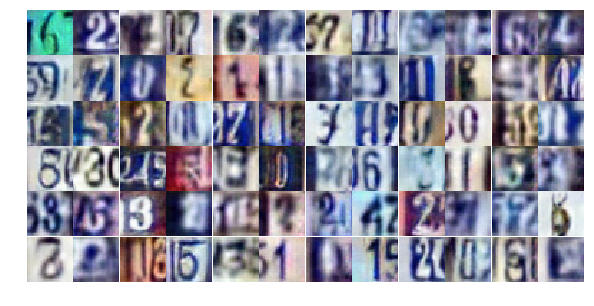

Epoch 21/25... Discriminator Loss: 0.3292... Generator Loss: 1.6591
Epoch 21/25... Discriminator Loss: 0.6757... Generator Loss: 1.0644
Epoch 21/25... Discriminator Loss: 2.0204... Generator Loss: 0.4516
Epoch 21/25... Discriminator Loss: 1.0014... Generator Loss: 0.7902
Epoch 21/25... Discriminator Loss: 0.3284... Generator Loss: 2.8148
Epoch 21/25... Discriminator Loss: 0.8236... Generator Loss: 0.8817
Epoch 21/25... Discriminator Loss: 1.2009... Generator Loss: 0.6064
Epoch 21/25... Discriminator Loss: 0.1836... Generator Loss: 2.3459
Epoch 21/25... Discriminator Loss: 0.3095... Generator Loss: 1.9678
Epoch 21/25... Discriminator Loss: 0.4791... Generator Loss: 1.4667


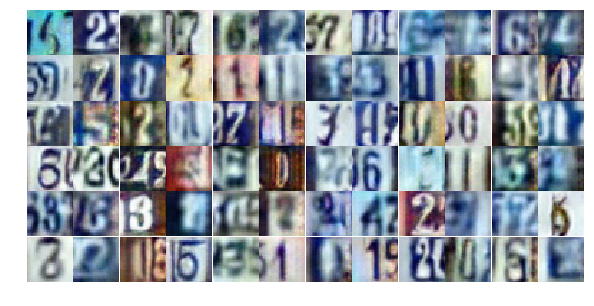

Epoch 21/25... Discriminator Loss: 2.1539... Generator Loss: 0.2060
Epoch 21/25... Discriminator Loss: 0.2833... Generator Loss: 2.5292
Epoch 21/25... Discriminator Loss: 1.7681... Generator Loss: 1.9977
Epoch 21/25... Discriminator Loss: 1.0952... Generator Loss: 0.7566
Epoch 21/25... Discriminator Loss: 1.0956... Generator Loss: 0.7165
Epoch 21/25... Discriminator Loss: 0.7880... Generator Loss: 1.0618
Epoch 21/25... Discriminator Loss: 0.5626... Generator Loss: 1.1142
Epoch 21/25... Discriminator Loss: 0.6861... Generator Loss: 1.0421
Epoch 21/25... Discriminator Loss: 1.0036... Generator Loss: 0.6141
Epoch 21/25... Discriminator Loss: 0.9794... Generator Loss: 0.8115


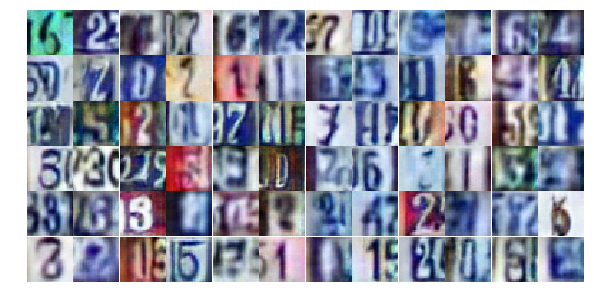

Epoch 21/25... Discriminator Loss: 0.7299... Generator Loss: 0.9708
Epoch 21/25... Discriminator Loss: 0.4916... Generator Loss: 1.3894
Epoch 21/25... Discriminator Loss: 0.8897... Generator Loss: 0.7565
Epoch 21/25... Discriminator Loss: 0.4703... Generator Loss: 1.3820
Epoch 21/25... Discriminator Loss: 0.4005... Generator Loss: 1.6525
Epoch 21/25... Discriminator Loss: 0.6321... Generator Loss: 1.0846
Epoch 21/25... Discriminator Loss: 0.6255... Generator Loss: 1.1699
Epoch 21/25... Discriminator Loss: 1.7314... Generator Loss: 0.4615
Epoch 21/25... Discriminator Loss: 1.2447... Generator Loss: 0.6833
Epoch 21/25... Discriminator Loss: 0.2318... Generator Loss: 4.0397


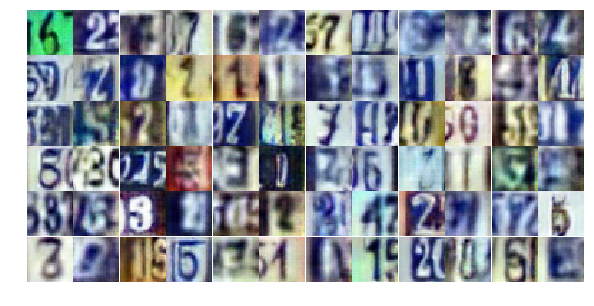

Epoch 21/25... Discriminator Loss: 0.6113... Generator Loss: 1.6755
Epoch 21/25... Discriminator Loss: 1.0999... Generator Loss: 0.6838
Epoch 21/25... Discriminator Loss: 0.4530... Generator Loss: 1.4696
Epoch 21/25... Discriminator Loss: 0.9815... Generator Loss: 0.7083
Epoch 21/25... Discriminator Loss: 0.3540... Generator Loss: 1.8898
Epoch 21/25... Discriminator Loss: 0.9753... Generator Loss: 0.6739
Epoch 21/25... Discriminator Loss: 0.7967... Generator Loss: 0.8837
Epoch 21/25... Discriminator Loss: 0.6507... Generator Loss: 1.0623
Epoch 21/25... Discriminator Loss: 0.5477... Generator Loss: 1.2322
Epoch 21/25... Discriminator Loss: 0.4421... Generator Loss: 1.4542


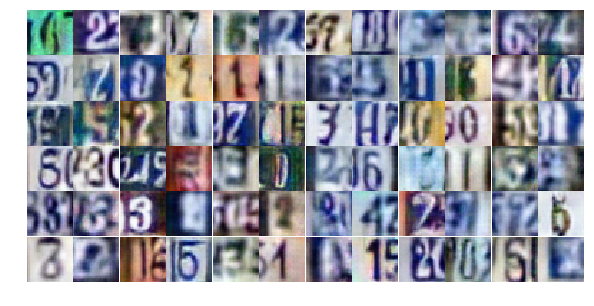

Epoch 21/25... Discriminator Loss: 0.3290... Generator Loss: 1.9175
Epoch 21/25... Discriminator Loss: 1.2215... Generator Loss: 0.5213
Epoch 21/25... Discriminator Loss: 1.0248... Generator Loss: 0.9712
Epoch 22/25... Discriminator Loss: 0.6147... Generator Loss: 2.5210
Epoch 22/25... Discriminator Loss: 0.6003... Generator Loss: 1.5665
Epoch 22/25... Discriminator Loss: 0.5969... Generator Loss: 1.1719
Epoch 22/25... Discriminator Loss: 0.3330... Generator Loss: 1.7587
Epoch 22/25... Discriminator Loss: 0.5332... Generator Loss: 1.2263
Epoch 22/25... Discriminator Loss: 0.9991... Generator Loss: 0.6858
Epoch 22/25... Discriminator Loss: 1.3228... Generator Loss: 0.4366


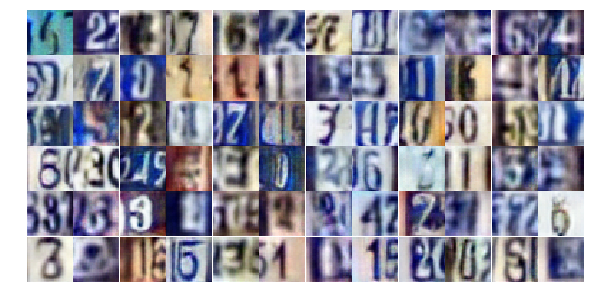

Epoch 22/25... Discriminator Loss: 0.3424... Generator Loss: 2.0621
Epoch 22/25... Discriminator Loss: 0.5667... Generator Loss: 2.2059
Epoch 22/25... Discriminator Loss: 1.4646... Generator Loss: 0.5230
Epoch 22/25... Discriminator Loss: 0.8514... Generator Loss: 0.9039
Epoch 22/25... Discriminator Loss: 0.5859... Generator Loss: 1.1712
Epoch 22/25... Discriminator Loss: 0.6813... Generator Loss: 4.0388
Epoch 22/25... Discriminator Loss: 2.1148... Generator Loss: 0.2513
Epoch 22/25... Discriminator Loss: 0.4683... Generator Loss: 2.8254
Epoch 22/25... Discriminator Loss: 1.6305... Generator Loss: 0.3829
Epoch 22/25... Discriminator Loss: 1.7609... Generator Loss: 0.3306


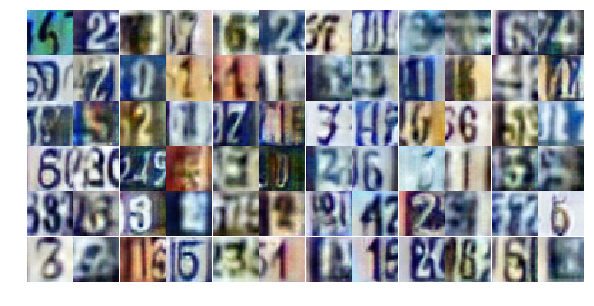

Epoch 22/25... Discriminator Loss: 0.2665... Generator Loss: 2.3106
Epoch 22/25... Discriminator Loss: 0.7548... Generator Loss: 1.0635
Epoch 22/25... Discriminator Loss: 0.8106... Generator Loss: 0.9800
Epoch 22/25... Discriminator Loss: 0.5114... Generator Loss: 1.2219
Epoch 22/25... Discriminator Loss: 0.3624... Generator Loss: 2.1310
Epoch 22/25... Discriminator Loss: 0.8842... Generator Loss: 0.7971
Epoch 22/25... Discriminator Loss: 0.4972... Generator Loss: 1.4325
Epoch 22/25... Discriminator Loss: 0.2821... Generator Loss: 2.1699
Epoch 22/25... Discriminator Loss: 0.5278... Generator Loss: 1.1728
Epoch 22/25... Discriminator Loss: 0.5361... Generator Loss: 1.2961


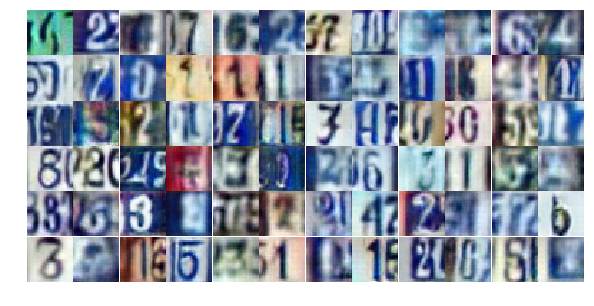

Epoch 22/25... Discriminator Loss: 0.2766... Generator Loss: 1.8861
Epoch 22/25... Discriminator Loss: 0.4597... Generator Loss: 1.3378
Epoch 22/25... Discriminator Loss: 1.0953... Generator Loss: 0.6099
Epoch 22/25... Discriminator Loss: 0.8375... Generator Loss: 0.8444
Epoch 22/25... Discriminator Loss: 0.8064... Generator Loss: 0.8509
Epoch 22/25... Discriminator Loss: 0.7950... Generator Loss: 0.7959
Epoch 22/25... Discriminator Loss: 1.1947... Generator Loss: 0.5720
Epoch 22/25... Discriminator Loss: 0.4458... Generator Loss: 1.4112
Epoch 22/25... Discriminator Loss: 0.6716... Generator Loss: 1.1330
Epoch 22/25... Discriminator Loss: 0.5689... Generator Loss: 1.2156


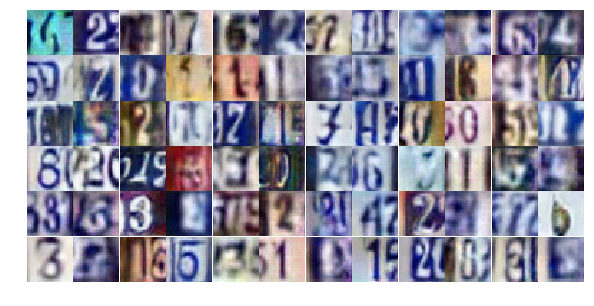

Epoch 22/25... Discriminator Loss: 0.7439... Generator Loss: 0.9436
Epoch 22/25... Discriminator Loss: 0.2510... Generator Loss: 2.0448
Epoch 22/25... Discriminator Loss: 0.2673... Generator Loss: 2.0609
Epoch 22/25... Discriminator Loss: 0.6413... Generator Loss: 1.0406
Epoch 22/25... Discriminator Loss: 0.4006... Generator Loss: 1.4460
Epoch 22/25... Discriminator Loss: 0.6480... Generator Loss: 1.0797
Epoch 22/25... Discriminator Loss: 1.1398... Generator Loss: 0.6893
Epoch 22/25... Discriminator Loss: 2.0753... Generator Loss: 0.4876
Epoch 22/25... Discriminator Loss: 1.6639... Generator Loss: 0.8221
Epoch 22/25... Discriminator Loss: 1.2251... Generator Loss: 0.5633


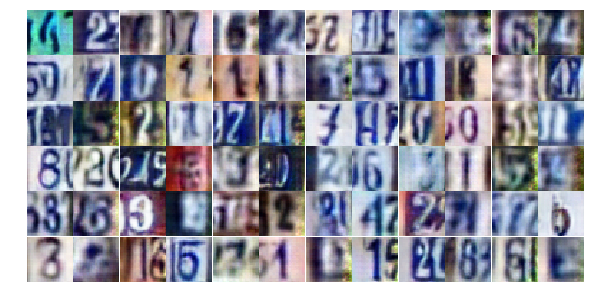

Epoch 22/25... Discriminator Loss: 0.7798... Generator Loss: 1.0787
Epoch 22/25... Discriminator Loss: 0.4041... Generator Loss: 2.1038
Epoch 22/25... Discriminator Loss: 1.0807... Generator Loss: 0.6070
Epoch 22/25... Discriminator Loss: 0.7692... Generator Loss: 0.9640
Epoch 22/25... Discriminator Loss: 0.8274... Generator Loss: 0.9514
Epoch 22/25... Discriminator Loss: 0.5705... Generator Loss: 1.4164
Epoch 22/25... Discriminator Loss: 0.7091... Generator Loss: 1.1487
Epoch 22/25... Discriminator Loss: 0.6537... Generator Loss: 1.1470
Epoch 22/25... Discriminator Loss: 0.9411... Generator Loss: 0.7899
Epoch 22/25... Discriminator Loss: 0.6132... Generator Loss: 1.2608


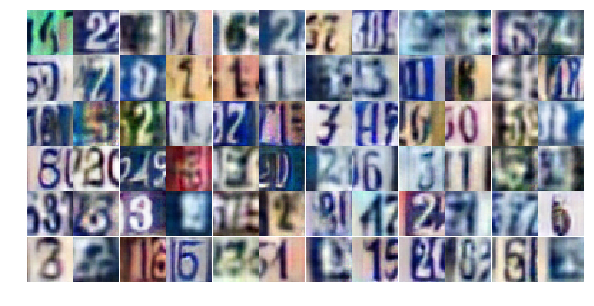

Epoch 23/25... Discriminator Loss: 0.5209... Generator Loss: 1.3677
Epoch 23/25... Discriminator Loss: 0.3226... Generator Loss: 2.0017
Epoch 23/25... Discriminator Loss: 1.0445... Generator Loss: 0.7299
Epoch 23/25... Discriminator Loss: 0.4588... Generator Loss: 1.4299
Epoch 23/25... Discriminator Loss: 0.6553... Generator Loss: 1.0994
Epoch 23/25... Discriminator Loss: 1.1301... Generator Loss: 0.6220
Epoch 23/25... Discriminator Loss: 1.5919... Generator Loss: 0.5447
Epoch 23/25... Discriminator Loss: 0.6179... Generator Loss: 1.1158
Epoch 23/25... Discriminator Loss: 0.5193... Generator Loss: 1.4098
Epoch 23/25... Discriminator Loss: 0.2364... Generator Loss: 2.4653


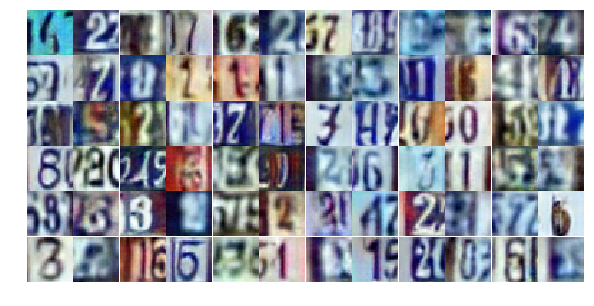

Epoch 23/25... Discriminator Loss: 0.5039... Generator Loss: 1.3886
Epoch 23/25... Discriminator Loss: 0.4552... Generator Loss: 1.3604
Epoch 23/25... Discriminator Loss: 1.0031... Generator Loss: 0.6450
Epoch 23/25... Discriminator Loss: 0.5926... Generator Loss: 1.1329
Epoch 23/25... Discriminator Loss: 0.3050... Generator Loss: 1.9467
Epoch 23/25... Discriminator Loss: 0.6213... Generator Loss: 1.1658
Epoch 23/25... Discriminator Loss: 0.7834... Generator Loss: 0.8575
Epoch 23/25... Discriminator Loss: 0.5494... Generator Loss: 1.2585
Epoch 23/25... Discriminator Loss: 0.6756... Generator Loss: 1.4057
Epoch 23/25... Discriminator Loss: 0.7809... Generator Loss: 0.9075


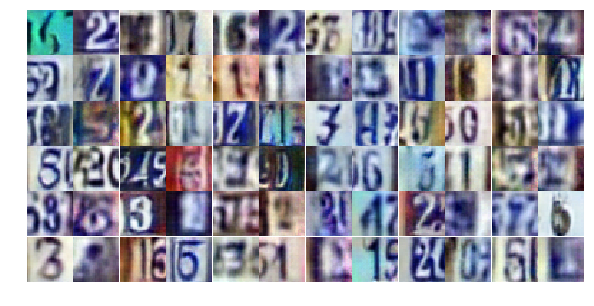

Epoch 23/25... Discriminator Loss: 1.2581... Generator Loss: 0.5571
Epoch 23/25... Discriminator Loss: 0.5766... Generator Loss: 1.1800
Epoch 23/25... Discriminator Loss: 0.9197... Generator Loss: 0.8263
Epoch 23/25... Discriminator Loss: 0.7661... Generator Loss: 0.8625
Epoch 23/25... Discriminator Loss: 0.4945... Generator Loss: 1.2927
Epoch 23/25... Discriminator Loss: 0.6568... Generator Loss: 1.0422
Epoch 23/25... Discriminator Loss: 0.5012... Generator Loss: 2.3503
Epoch 23/25... Discriminator Loss: 0.9266... Generator Loss: 0.8328
Epoch 23/25... Discriminator Loss: 0.2855... Generator Loss: 2.3137
Epoch 23/25... Discriminator Loss: 0.4420... Generator Loss: 1.8413


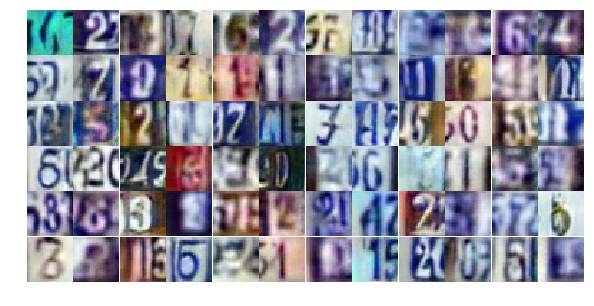

Epoch 23/25... Discriminator Loss: 0.6575... Generator Loss: 0.9734
Epoch 23/25... Discriminator Loss: 0.4897... Generator Loss: 1.3867
Epoch 23/25... Discriminator Loss: 0.4942... Generator Loss: 1.3971
Epoch 23/25... Discriminator Loss: 0.8135... Generator Loss: 0.7838
Epoch 23/25... Discriminator Loss: 0.5636... Generator Loss: 1.3403
Epoch 23/25... Discriminator Loss: 0.7830... Generator Loss: 0.8640
Epoch 23/25... Discriminator Loss: 0.6698... Generator Loss: 1.0144
Epoch 23/25... Discriminator Loss: 0.3402... Generator Loss: 1.7553
Epoch 23/25... Discriminator Loss: 0.5583... Generator Loss: 1.1612
Epoch 23/25... Discriminator Loss: 0.3602... Generator Loss: 1.5373


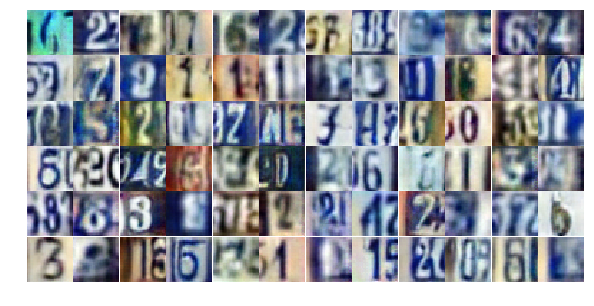

Epoch 23/25... Discriminator Loss: 0.6274... Generator Loss: 1.1027
Epoch 23/25... Discriminator Loss: 0.4104... Generator Loss: 2.7036
Epoch 23/25... Discriminator Loss: 1.1935... Generator Loss: 0.6554
Epoch 23/25... Discriminator Loss: 1.3987... Generator Loss: 0.6533
Epoch 23/25... Discriminator Loss: 0.6685... Generator Loss: 4.7003
Epoch 23/25... Discriminator Loss: 0.8363... Generator Loss: 1.5889
Epoch 23/25... Discriminator Loss: 2.5287... Generator Loss: 0.4111
Epoch 23/25... Discriminator Loss: 1.6490... Generator Loss: 0.4958
Epoch 23/25... Discriminator Loss: 0.9189... Generator Loss: 0.8535
Epoch 23/25... Discriminator Loss: 0.6748... Generator Loss: 1.4093


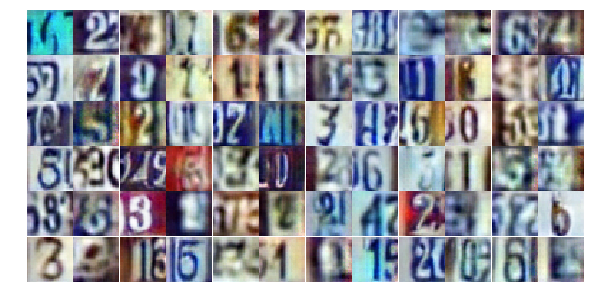

Epoch 23/25... Discriminator Loss: 0.7903... Generator Loss: 0.9267
Epoch 23/25... Discriminator Loss: 1.6840... Generator Loss: 0.3060
Epoch 23/25... Discriminator Loss: 0.7076... Generator Loss: 1.3057
Epoch 23/25... Discriminator Loss: 0.2488... Generator Loss: 2.3999
Epoch 23/25... Discriminator Loss: 1.4210... Generator Loss: 0.4841
Epoch 23/25... Discriminator Loss: 0.4428... Generator Loss: 1.9723
Epoch 23/25... Discriminator Loss: 0.6794... Generator Loss: 1.0245
Epoch 24/25... Discriminator Loss: 0.4644... Generator Loss: 1.4065
Epoch 24/25... Discriminator Loss: 0.5836... Generator Loss: 1.2290
Epoch 24/25... Discriminator Loss: 0.6876... Generator Loss: 2.5324


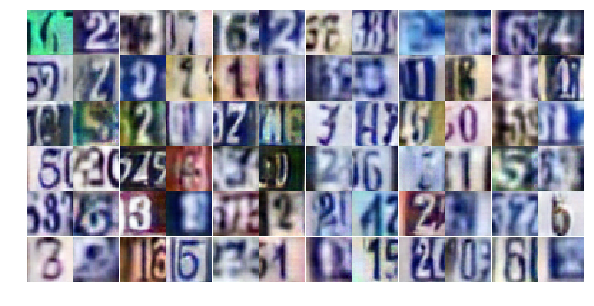

Epoch 24/25... Discriminator Loss: 0.4233... Generator Loss: 1.9384
Epoch 24/25... Discriminator Loss: 0.5083... Generator Loss: 1.5125
Epoch 24/25... Discriminator Loss: 0.8525... Generator Loss: 0.8560
Epoch 24/25... Discriminator Loss: 0.8675... Generator Loss: 0.8459
Epoch 24/25... Discriminator Loss: 0.3898... Generator Loss: 1.5751
Epoch 24/25... Discriminator Loss: 0.5700... Generator Loss: 1.2146
Epoch 24/25... Discriminator Loss: 0.5797... Generator Loss: 1.1454
Epoch 24/25... Discriminator Loss: 1.0326... Generator Loss: 0.6936
Epoch 24/25... Discriminator Loss: 0.5094... Generator Loss: 1.2760
Epoch 24/25... Discriminator Loss: 0.3030... Generator Loss: 1.9147


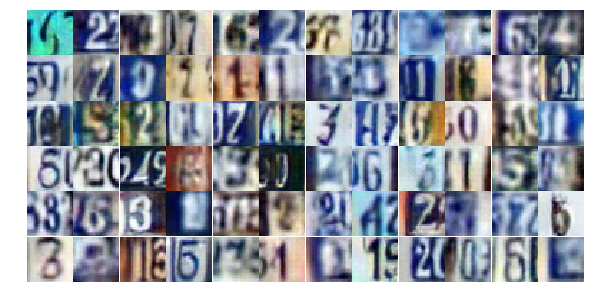

Epoch 24/25... Discriminator Loss: 1.4879... Generator Loss: 0.4810
Epoch 24/25... Discriminator Loss: 0.7579... Generator Loss: 0.9125
Epoch 24/25... Discriminator Loss: 0.6919... Generator Loss: 1.0730
Epoch 24/25... Discriminator Loss: 0.4820... Generator Loss: 1.3411
Epoch 24/25... Discriminator Loss: 0.6528... Generator Loss: 1.1389
Epoch 24/25... Discriminator Loss: 0.9662... Generator Loss: 0.7358
Epoch 24/25... Discriminator Loss: 0.5623... Generator Loss: 1.1529
Epoch 24/25... Discriminator Loss: 0.7140... Generator Loss: 1.0500
Epoch 24/25... Discriminator Loss: 0.8367... Generator Loss: 0.8683
Epoch 24/25... Discriminator Loss: 1.6510... Generator Loss: 0.3739


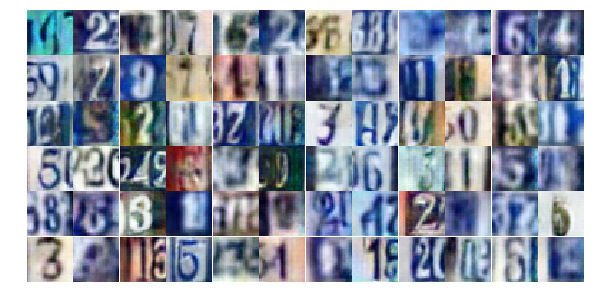

Epoch 24/25... Discriminator Loss: 3.9026... Generator Loss: 0.0605
Epoch 24/25... Discriminator Loss: 0.8204... Generator Loss: 1.0627
Epoch 24/25... Discriminator Loss: 0.5275... Generator Loss: 1.5408
Epoch 24/25... Discriminator Loss: 1.0063... Generator Loss: 0.8617
Epoch 24/25... Discriminator Loss: 0.5214... Generator Loss: 1.2300
Epoch 24/25... Discriminator Loss: 0.4324... Generator Loss: 1.4756
Epoch 24/25... Discriminator Loss: 0.4393... Generator Loss: 1.3927
Epoch 24/25... Discriminator Loss: 0.4394... Generator Loss: 1.9333
Epoch 24/25... Discriminator Loss: 0.4106... Generator Loss: 1.6068
Epoch 24/25... Discriminator Loss: 0.4360... Generator Loss: 2.1830


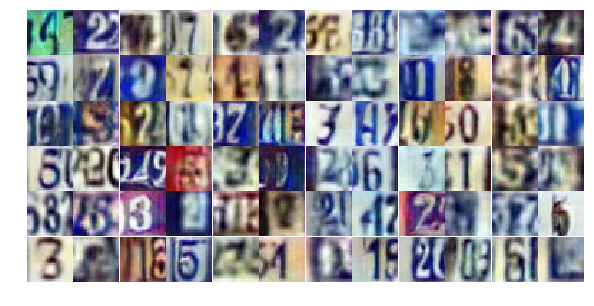

Epoch 24/25... Discriminator Loss: 0.3039... Generator Loss: 2.1661
Epoch 24/25... Discriminator Loss: 0.7754... Generator Loss: 1.0018
Epoch 24/25... Discriminator Loss: 0.8888... Generator Loss: 0.7725
Epoch 24/25... Discriminator Loss: 0.8874... Generator Loss: 0.8110
Epoch 24/25... Discriminator Loss: 1.1000... Generator Loss: 0.6960
Epoch 24/25... Discriminator Loss: 0.4803... Generator Loss: 1.3521
Epoch 24/25... Discriminator Loss: 1.0547... Generator Loss: 0.6122
Epoch 24/25... Discriminator Loss: 0.5018... Generator Loss: 1.3261
Epoch 24/25... Discriminator Loss: 0.6813... Generator Loss: 1.0637
Epoch 24/25... Discriminator Loss: 0.9120... Generator Loss: 0.7682


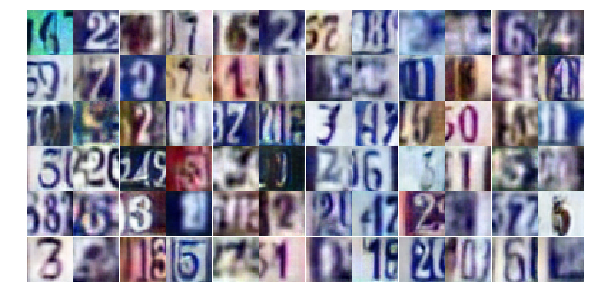

Epoch 24/25... Discriminator Loss: 0.6446... Generator Loss: 1.1149
Epoch 24/25... Discriminator Loss: 0.3314... Generator Loss: 1.6821
Epoch 24/25... Discriminator Loss: 0.5204... Generator Loss: 1.5045
Epoch 24/25... Discriminator Loss: 1.5489... Generator Loss: 0.4002
Epoch 24/25... Discriminator Loss: 2.3950... Generator Loss: 0.1741
Epoch 24/25... Discriminator Loss: 0.7509... Generator Loss: 1.1119
Epoch 24/25... Discriminator Loss: 0.9117... Generator Loss: 0.8757
Epoch 24/25... Discriminator Loss: 0.6799... Generator Loss: 1.0865
Epoch 24/25... Discriminator Loss: 1.0089... Generator Loss: 0.6799
Epoch 24/25... Discriminator Loss: 1.3720... Generator Loss: 0.4873


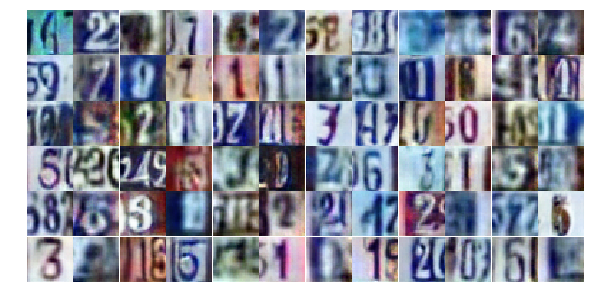

Epoch 24/25... Discriminator Loss: 0.9417... Generator Loss: 0.7975
Epoch 24/25... Discriminator Loss: 0.9660... Generator Loss: 0.7034
Epoch 24/25... Discriminator Loss: 0.4180... Generator Loss: 2.0761
Epoch 24/25... Discriminator Loss: 0.6732... Generator Loss: 1.1440
Epoch 24/25... Discriminator Loss: 1.0443... Generator Loss: 0.8621
Epoch 25/25... Discriminator Loss: 0.3566... Generator Loss: 1.8692
Epoch 25/25... Discriminator Loss: 0.3266... Generator Loss: 2.2628
Epoch 25/25... Discriminator Loss: 0.6230... Generator Loss: 1.1868
Epoch 25/25... Discriminator Loss: 0.6160... Generator Loss: 1.0863
Epoch 25/25... Discriminator Loss: 1.6333... Generator Loss: 0.3298


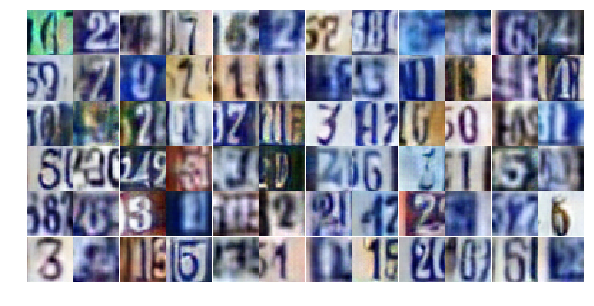

Epoch 25/25... Discriminator Loss: 0.8651... Generator Loss: 0.9281
Epoch 25/25... Discriminator Loss: 0.6585... Generator Loss: 1.1510
Epoch 25/25... Discriminator Loss: 0.2206... Generator Loss: 2.4841
Epoch 25/25... Discriminator Loss: 0.5824... Generator Loss: 1.2018
Epoch 25/25... Discriminator Loss: 0.4886... Generator Loss: 1.4919
Epoch 25/25... Discriminator Loss: 0.7224... Generator Loss: 0.9695
Epoch 25/25... Discriminator Loss: 0.4480... Generator Loss: 1.6326
Epoch 25/25... Discriminator Loss: 0.4252... Generator Loss: 2.2249
Epoch 25/25... Discriminator Loss: 0.4772... Generator Loss: 1.5694
Epoch 25/25... Discriminator Loss: 0.3817... Generator Loss: 1.7103


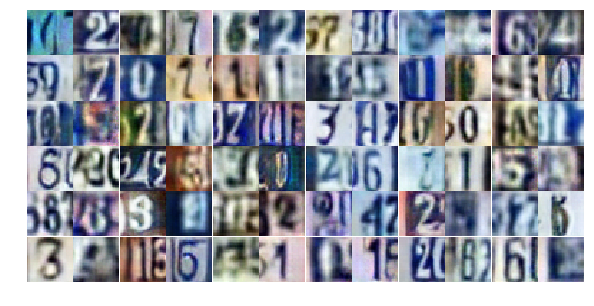

Epoch 25/25... Discriminator Loss: 0.7147... Generator Loss: 1.0795
Epoch 25/25... Discriminator Loss: 0.2754... Generator Loss: 2.0008
Epoch 25/25... Discriminator Loss: 1.5051... Generator Loss: 0.4589
Epoch 25/25... Discriminator Loss: 0.7028... Generator Loss: 1.0394
Epoch 25/25... Discriminator Loss: 0.7162... Generator Loss: 1.0079
Epoch 25/25... Discriminator Loss: 0.2458... Generator Loss: 2.5482
Epoch 25/25... Discriminator Loss: 0.6624... Generator Loss: 1.1226
Epoch 25/25... Discriminator Loss: 0.8002... Generator Loss: 0.9415
Epoch 25/25... Discriminator Loss: 0.4095... Generator Loss: 1.5080
Epoch 25/25... Discriminator Loss: 0.4844... Generator Loss: 1.3917


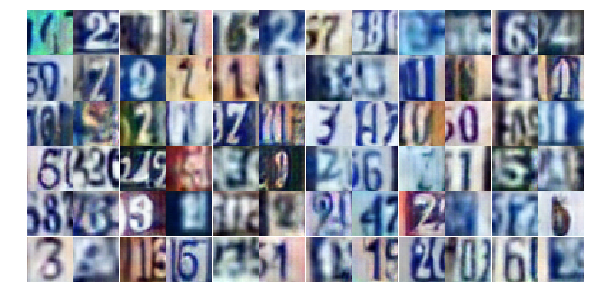

Epoch 25/25... Discriminator Loss: 0.2946... Generator Loss: 2.0446
Epoch 25/25... Discriminator Loss: 0.6781... Generator Loss: 1.1708
Epoch 25/25... Discriminator Loss: 2.1286... Generator Loss: 0.3684
Epoch 25/25... Discriminator Loss: 1.0139... Generator Loss: 0.7711


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

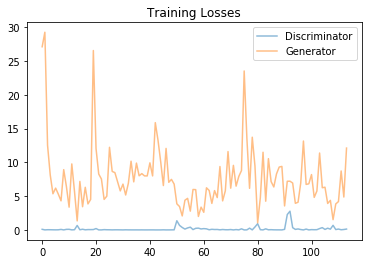

In [21]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

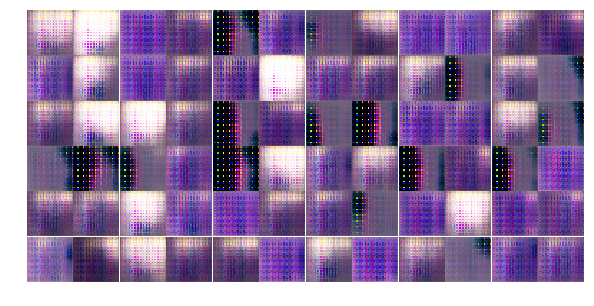

In [22]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))